In [1]:
import numpy as np
import reservoirpy as rpy
from reservoirpy.nodes import Reservoir, Ridge, NVAR
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from scipy.integrate import solve_ivp
import lyapynov
import nolds
import reservoirpy as rpy
from reservoirpy import verbosity



In [2]:
a = 6
b = 0.1
def LiSprott(t, X):
    x, y, z, u = X
    return np.array([y - x,
                     -x * z + u,
                     x * y - a,
                     -b * y])

In [ ]:
# for i in tqdm(range(10)):
#     start_point = np.array([np.random.uniform(low=-0.5, high=0.5), 4, 0, -5])
#     sol = solve_ivp(LiSprott, [0, 1000], 
#                     start_point, t_eval=np.arange(0, 1000, 0.01), rtol = 1e-11, atol = 1e-11, dense_output=True)
#     np.save("data/LiSprottNoNoise0_01StepTestDataCorrectSystem"+str(i), sol.y)

  0%|          | 0/10 [00:00<?, ?it/s]

In [ ]:
# for i in tqdm(range(200)):
#     start_point = np.array([np.random.uniform(low=-0.5, high=0.5), 4, 0, -5])
#     sol = solve_ivp(LiSprott, [0, 1000], 
#                     start_point, t_eval=np.arange(0, 1000, 0.01), rtol = 1e-11, atol = 1e-11, dense_output=True)
#     np.save("data/LiSprottNoNoise0_01StepCorrectSystem"+str(i), sol.y)

  0%|          | 0/200 [00:00<?, ?it/s]

In [12]:
test_trajectorys = []
for i in range(10):
    test_trajectorys.append(np.load("data/LiSprottNoNoise0_01StepTestDataCorrectSystem"+str(i) + ".npy"))

In [3]:
trajectorys = []
for i in tqdm(range(200)):
    trajectorys.append(np.load("data/LiSprottNoNoise0_01StepCorrectSystem"+str(i) + ".npy"))

  0%|          | 0/200 [00:00<?, ?it/s]

In [9]:
print("Тип данных ряда:", type(trajectorys[0][0][0]))

Тип данных ряда: <class 'numpy.float64'>


In [10]:
trajectorys[0][0].shape

(100000,)

In [15]:
lyap_max = nolds.lyap_e(trajectorys[0][0])

In [16]:
lyap_max

array([ 0.05048564,  0.01442755, -0.0217761 , -0.13353172])

In [17]:
1 / lyap_max.max()

19.807611858420817

In [5]:
start_point = np.array([0, 4, 0, -5])
sol = solve_ivp(LiSprott, [0, 1000], 
                     start_point, t_eval=np.arange(0, 1000, 0.01), rtol = 1e-11, atol = 1e-11, dense_output=True)
test_trajectory = sol.y

In [4]:
# Создаем пользовательский класс Reservoir с методом Рунге-Кутта 4-го порядка
class RK4Reservoir(Reservoir):
    def __init__(self, units, input_gain, W, Win, bias):
        super().__init__(units=units, W=W, Win=Win, bias=bias)
        self.input_gain = input_gain
        self.bias = bias

    def _forward(self, u):
        # Получаем текущее состояние резервуара
        x = self.state()

        # Получаем параметры
        W_in = self.input_weights
        W_res = self.internal_weights
        G = self.input_gain
        B = self.bias

        # Функция динамики резервуара
        def f(x, u):
            return -x + np.tanh(W_res @ x + G * W_in @ u + B)

        # Шаг времени
        dt = 0.1

        # Метод Рунге-Кутта 4-го порядка
        k1 = f(x, u)
        k2 = f(x + 0.5 * dt * k1, u)
        k3 = f(x + 0.5 * dt * k2, u)
        k4 = f(x + dt * k3, u)

        # Обновляем состояние
        x_new = x + (dt / 6) * (k1 + 2 * k2 + 2 * k3 + k4)

        # Сохраняем новое состояние
        self.set_state(x_new)

        return x_new

In [5]:
np.random.seed(42)



# Параметры резервуара
# Параметры резервуара
N = 300  # Размер резервуара
bias_p = 3 
G = 0.01 # The strength of the input weights
sparsity = 0.1  # Разреженность 0.1, возможно имелось ввиду 0.9
rho = 0.99 # Спектральный радиус
input_dim = 4

# Инициализация резервуара
W_res = np.random.uniform(-1, 1, (N, N))
mask = np.random.rand(N, N) < sparsity  # Sparsity mask
W_res *= mask

eigenvalues = np.linalg.eigvals(W_res)
current_rho = np.max(np.abs(eigenvalues))  # for input_dim = 3
W_res = (rho / current_rho) * W_res

W_in = np.zeros((N, input_dim))
for row in range(N):
    column = np.random.randint(0, input_dim)
    W_in[row][column] = np.random.uniform(-1, 1)

B = np.random.uniform(-bias_p, bias_p, (N, 1)) # Смещение

lr = 1.0  # Параметр утечки (leak rate)


# Создаем резервуар с пользовательским методом обновления
reservoir = RK4Reservoir(units=N, input_gain=G, W=W_res, Win=W_in, bias=B)


# Параметры эксперимента
theta = 2.5  # Длина интервала входного сигнала
Tw_solo = 3000  
Tw = 2500 # Время "прогрева" в шагах
record_time = 7500  # Время записи в временных единицах
dt = 0.1
#record_steps = int(record_time / dt)
#input_dim = 4  # Размерность входного сигнала

In [8]:
#readout.fit(state_matrix, target_sequence)

In [6]:
def CalculateMatrices(trajectorys, dim=4):
    np.random.seed(42)
    N = 300  # Размер резервуара
    bias_p = 3 
    G = 0.01 # The strength of the input weights
    sparsity = 0.1  # Разреженность 0.1, возможно имелось ввиду 0.9
    rho = 0.99 # Спектральный радиус

    # Инициализация резервуара
    W_res = np.random.uniform(-1, 1, (N, N))
    mask = np.random.rand(N, N) < sparsity  # Sparsity mask
    W_res *= mask

    eigenvalues = np.linalg.eigvals(W_res)
    current_rho = np.max(np.abs(eigenvalues))
    W_res = (rho / current_rho) * W_res

    W_in = np.zeros((N, dim))
    for row in range(N):
        column = np.random.randint(0, dim)
        W_in[row][column] = np.random.uniform(-1, 1)

    B = np.random.uniform(-bias_p, bias_p, (N, 1)) # Смещение

    lr = 1.0  # Параметр утечки (leak rate)


    # Создаем резервуар с пользовательским методом обновления
    reservoir = RK4Reservoir(units=N, input_gain=G, W=W_res, Win=W_in, bias=B)


    # Параметры эксперимента
    theta = 2.5  # Длина интервала входного сигнала
    Tw_solo = 3000  
    Tw = 2500 # Время "прогрева" в шагах
    record_time = 7500  # Время записи в временных единицах
    dt = 0.1
    #record_steps = int(record_time / dt)
    input_dim = dim  # Размерность входного сигнала
    all_matrices = []
    for i in tqdm(range(1, 11)):
        #print("Шаг: ", i)
        matrices = []
        for j in tqdm(range(0, len(trajectorys)-i, i), leave=False):
            input_sequences = trajectorys[j:j+i]
            train_record_steps = input_sequences[0].shape[0] - Tw - 1# int(theta / dt) # 1 /  dt
            target_sequences = [input_sequence[Tw+1:] for input_sequence in input_sequences]
            state_matrix = []

            for c in range(i):
                input_sequence = input_sequences[c]
                reservoir.reset()
                #Прогрев резервуара без входа
                for t in range(Tw_solo):
                    reservoir(np.zeros(dim))

                # Прогрев резервуара
                for t in range(Tw):
                    for reservoir_step in range(int(theta / dt)):
                        reservoir(input_sequence[t])

                # Запись состояний резервуара
                for t in range(Tw, Tw + train_record_steps):
                    state = None
                    for reservoir_step in range(int(theta / dt)):
                        state = reservoir(input_sequence[t])
                    #if t % int(theta / dt) == 0:  # Записываем состояние каждые theta временных единиц
                    state_matrix.append(np.append(state, 1))  # Добавляем bias term
                    
                
                
                


            readout = Ridge(ridge=1e-7, input_bias=False)
            states = np.array(state_matrix)
            Y_train = np.concatenate(target_sequences)


            readout.fit(states, Y_train)
                
            matrices.append(readout.params["Wout"])
        all_matrices.append(matrices)
    return all_matrices

In [ ]:
trajectorys_resample = [trajectory.T[::10] for trajectory in trajectorys]
all_matrices = CalculateMatrices(trajectorys_resample)
np.savez("predicts/all201_matricesCorrectSystem.npz", *all_matrices)


  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/199 [00:00<?, ?it/s]

  0%|          | 0/99 [00:00<?, ?it/s]

  0%|          | 0/66 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/39 [00:00<?, ?it/s]

  0%|          | 0/33 [00:00<?, ?it/s]

In [ ]:
#np.savez("predicts/all201_matricesCorrectSystem.npz", *all_matrices)

In [28]:
loaded_data = np.load("predicts/all201_matrices.npz")#np.load("predicts/all201_matricesCorrectSystem.npz")
loaded_matrices = [loaded_data[f'arr_{i}'] for i in range(len(loaded_data.files))]

In [29]:
# for i, block in enumerate(all_matrices):
#     for j, matrix in enumerate(block):
#         assert (loaded_matrices[i][j] == matrix).all()

In [30]:
def CalculateDistance(v1, v2):
    return np.sqrt((v1 - v2)**2)

def CalculateMeanStd(all_matrices, frobenius=True):
    means = []
    stds = []
    all_distances = []

    for matrices in all_matrices:
        distances = []
        for index, matrix1 in enumerate(matrices):
            for matrix2 in matrices[index+1:]:
                distance = np.linalg.norm(matrix1 - matrix2) if frobenius else CalculateDistance(matrix1, matrix2)

                distances.append(distance)
        means.append(np.mean(distances))
        stds.append(np.std(distances))
        all_distances.append(distances)  
    return np.array(means), np.array(stds), all_distances

In [31]:
means, stds, distances = CalculateMeanStd(loaded_matrices)

In [32]:
perc10 = [np.percentile(distances[i], 10) for i in range(len(distances))]
perc90 = [np.percentile(distances[i], 90) for i in range(len(distances))]


# Расстояние матриц

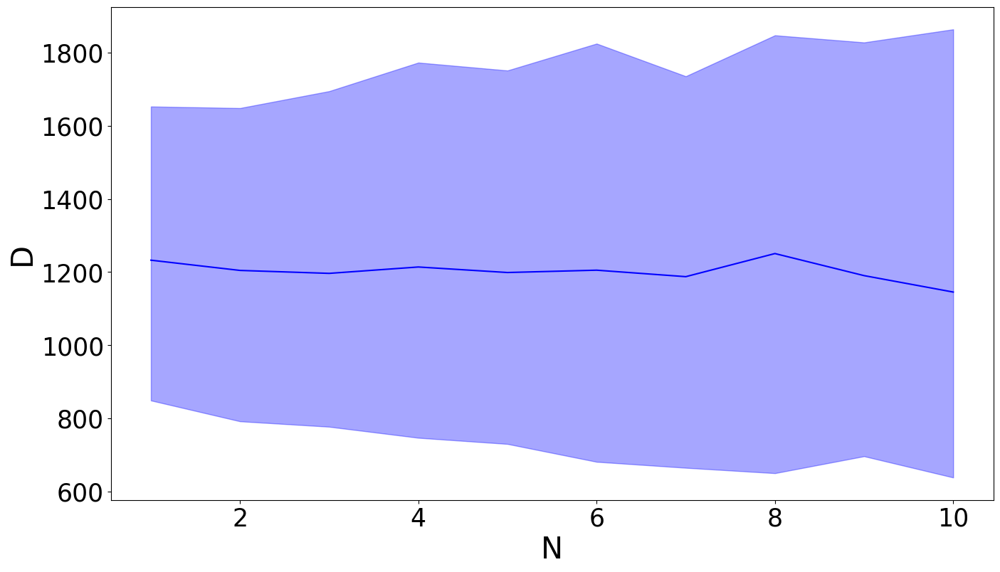

In [17]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot()
ax.plot(np.arange(1, 11), means, color="blue")
ax.fill_between(np.arange(1, 11), perc10, perc90, alpha=0.35, color="blue")

ax.set_xlabel("N", size=30)
ax.set_ylabel("D", size=30)
ax.tick_params(axis='both', which='major', labelsize=25)

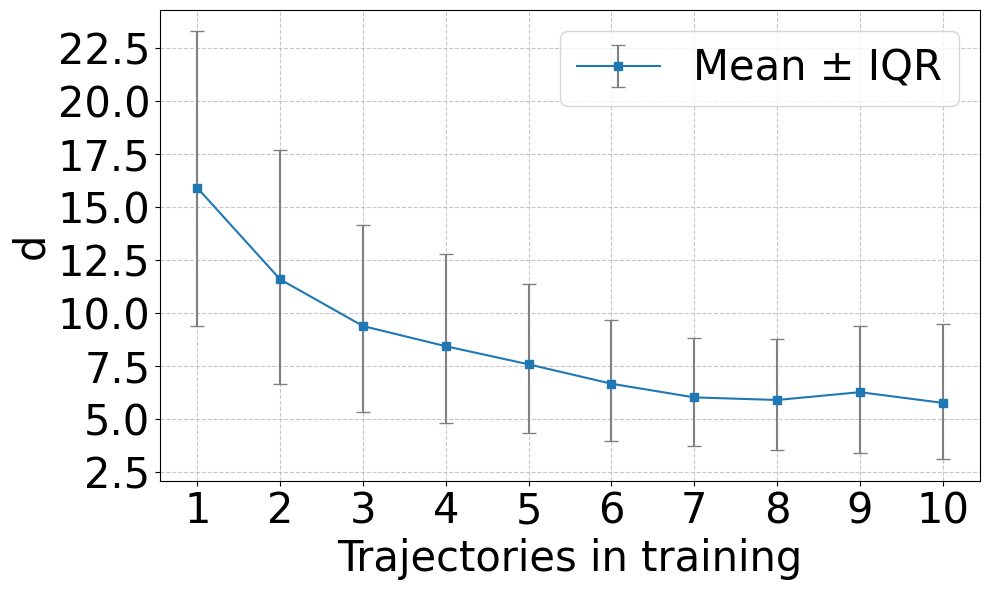

In [33]:
plt.figure(figsize=(10, 6))
plt.errorbar(
    x=range(1, 11),
    y=means,
    yerr=[means - perc10, perc90 - means],
    fmt='-s',
    ecolor='gray',
    capsize=5,
    label='Mean ± IQR'
)

#plt.title('Trend of Values Across Time Steps (Median with IQR)')
plt.xlabel('Trajectories in training', fontsize=30)
plt.ylabel('d', fontsize=30)
plt.grid(True, linestyle='--', alpha=0.7)
plt.xticks(range(1, 11), fontsize=30)
plt.yticks(fontsize=30)

plt.legend(fontsize=30)
plt.tight_layout()
plt.show()

In [10]:
def ReservoirPredict(trajectory, reservoir, Wout, dim=4):
    reservoir.reset()

    for t in range(Tw_solo):
        reservoir(np.zeros(dim))

    # Прогрев резервуара
    for t in range(Tw):
        for reservoir_step in range(int(theta / dt)):
            reservoir(trajectory[t])

    points = []
    point = trajectory[Tw]
    for t in range(Tw, Tw + 7499): #50000
        state = None
        for reservoir_step in range(int(theta / dt)):
            state = reservoir(point)
        
        new_point = np.append(state, 1) @ Wout

        
        points.append(new_point)
        point = new_point
    return np.array(points)

In [13]:
#test_trajectory_resampled = test_trajectory[:, ::10].T
test_trajectorys_resampled = [test_trajectory[:, ::10].T for test_trajectory in test_trajectorys]


In [73]:
long_trajectory_predicts = []
for i in tqdm(range(20)):
    predicts = ReservoirPredict(test_trajectory_resampled, reservoir, loaded_matrices[8][i])
    long_trajectory_predicts.append(predicts)

  0%|          | 0/20 [00:00<?, ?it/s]

In [ ]:
#np.savez("predicts/long_trajectory_predicts9.npz", *long_trajectory_predicts)


In [70]:
long_trajectory_predicts[0].shape

(7499, 4)

## Длинные траектории

In [ ]:
fig = plt.figure(figsize=(8, 6 * 20))

for j in range(20):
    ax = fig.add_subplot(20, 1, j+1, projection='3d')
    ax.plot(long_trajectory_predicts[j][:, 0], long_trajectory_predicts[j][:, 1], long_trajectory_predicts[j][:, 2])

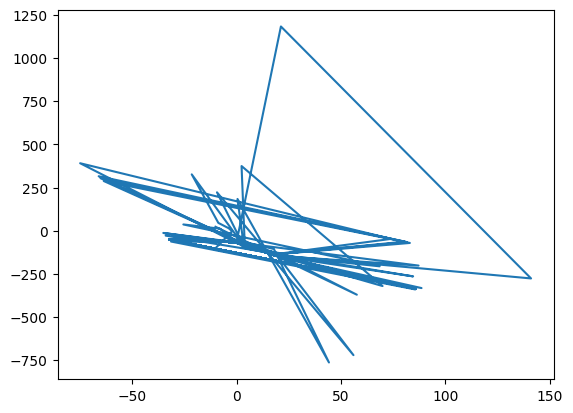

In [25]:
plt.plot(predicts[:, 0], predicts[:, 1])

In [ ]:
test_trajectorys_predicts = []
for traj_number, test_trajectory_resampled in enumerate(test_trajectorys_resampled):
    print("Траектория ", traj_number)
    all_matrices_predicts = []
    for i in tqdm(range(len(loaded_matrices)), leave=False):
        current_matrices_predicts = []
        for j in tqdm(range(19), leave=False):#len(loaded_matrices[i])):
            predicts = ReservoirPredict(test_trajectory_resampled, reservoir, loaded_matrices[i][j])
            current_matrices_predicts.append(predicts)
        all_matrices_predicts.append(np.array(current_matrices_predicts))
    test_trajectorys_predicts.append(np.array(all_matrices_predicts))
np.save("predicts/10Trajectorys_predictsCorrectSystem", test_trajectorys_predicts)

Траектория  0


  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/19 [00:00<?, ?it/s]

In [23]:
test_trajectorys_predicts[2].shape

(10, 20, 7499, 4)

In [ ]:
#np.save("predicts/10Trajectorys_predictsCorrectSystem", test_trajectorys_predicts)


In [2]:
loaded_data = np.load("predicts/all201_matrices_predicts.npz")
all_matrices_predicts = [loaded_data[f'arr_{i}'] for i in range(len(loaded_data.files))]


# Отрисовка

## Пример

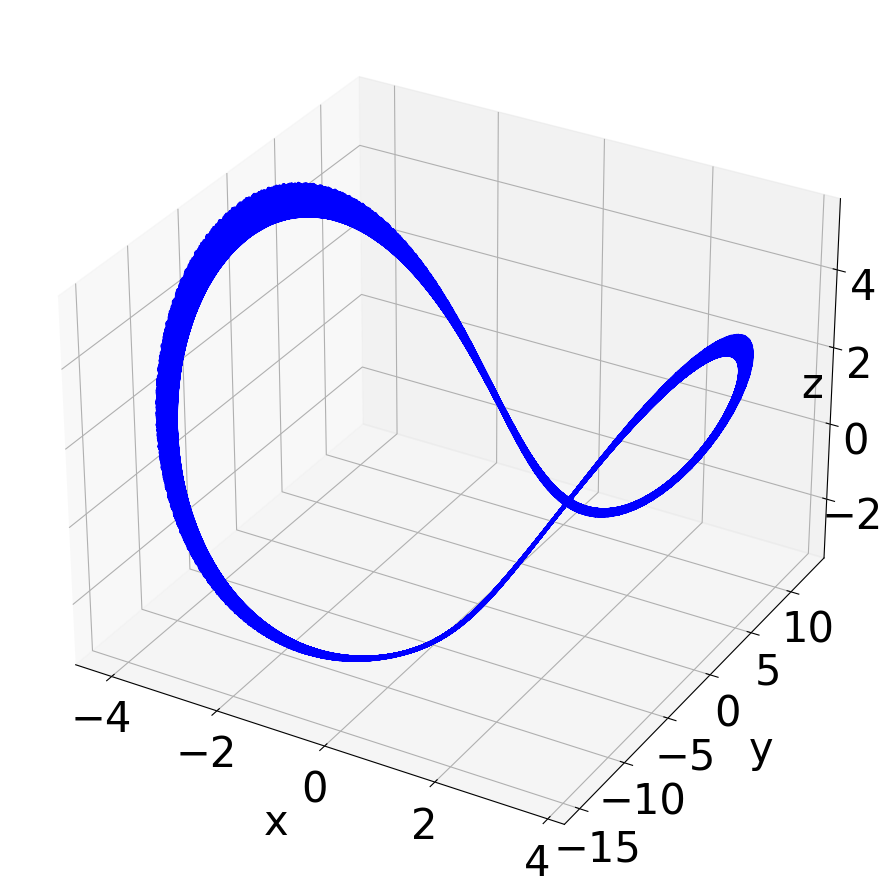

In [8]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot(projection='3d')
ax.plot(test_trajectory_resampled[1000:, 0], test_trajectory_resampled[1000:, 1], test_trajectory_resampled[1000:, 2], color="blue")

ax.set_xlabel("x", size=30, labelpad=20)
ax.set_ylabel("y", size=30, labelpad=20)
ax.set_zlabel("z", size=30, labelpad=-30)

ax.tick_params(axis='both', which='major', labelsize=30)

plt.tight_layout()

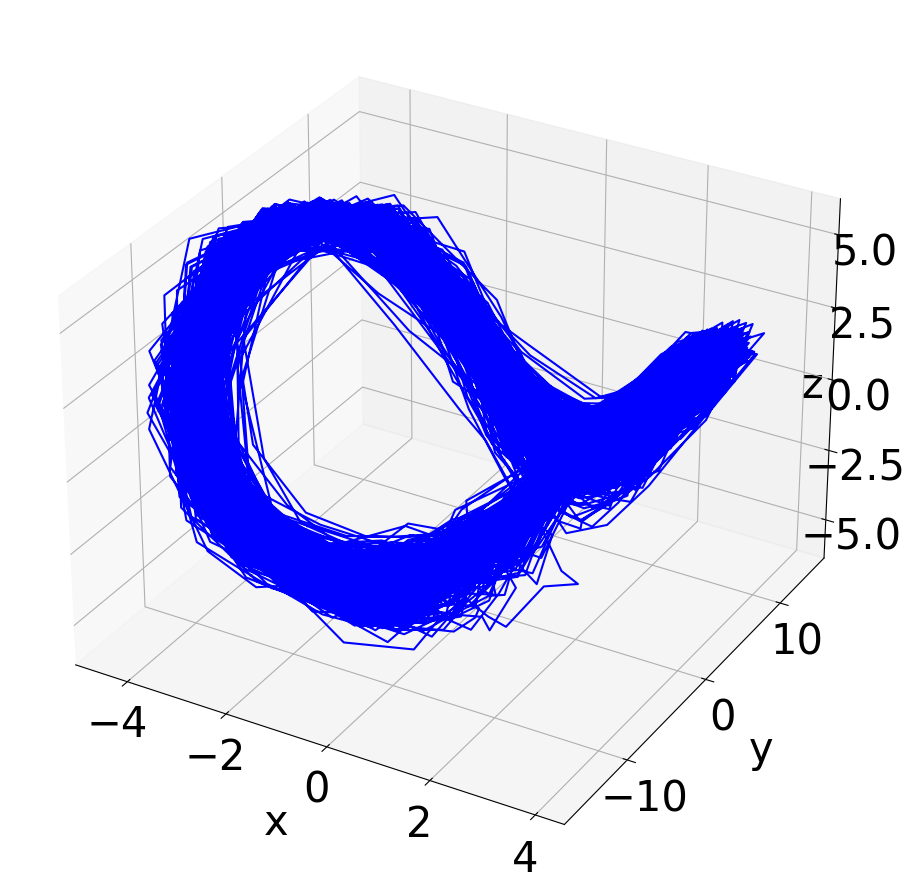

In [91]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot(projection='3d')
ax.plot(all_matrices_predicts[0][0][:, 0], all_matrices_predicts[0][0][:, 1], all_matrices_predicts[0][0][:, 2], color="blue")

ax.set_xlabel("x", size=30, labelpad=20)
ax.set_ylabel("y", size=30, labelpad=20)
ax.set_zlabel("z", size=30, labelpad=-30)

ax.tick_params(axis='both', which='major', labelsize=30)

plt.tight_layout()

## Все предсказания

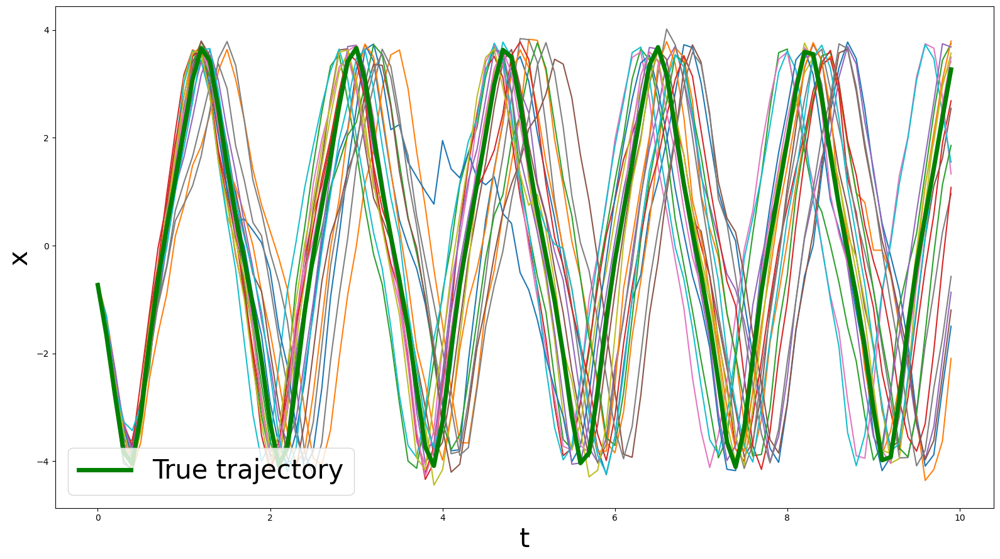

In [19]:
plt.figure(figsize=(16, 9))

# Рисуем графики
#for row, i in enumerate([0, 5, 9]):
for j in range(20):
    plt.plot(np.arange(0, 10, 0.1), all_matrices_predicts[0][j][:, 0][:100])
plt.plot(np.arange(0, 10, 0.1), test_trajectory_resampled[2501:2601, 0], label="True trajectory", color="Green", linewidth = 5)

#plt.title(str(1) + ' trajectory in training')
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.legend(fontsize=30)
plt.tight_layout()

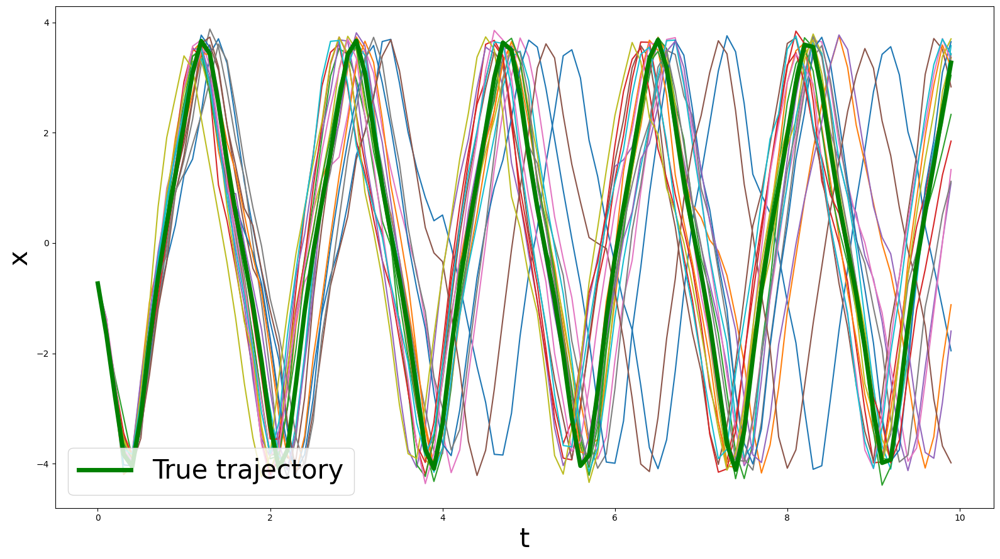

In [21]:
plt.figure(figsize=(16, 9))

# Рисуем графики
#for row, i in enumerate([0, 5, 9]):
for j in range(20):
    plt.plot(np.arange(0, 10, 0.1), all_matrices_predicts[5][j][:, 0][:100])
plt.plot(np.arange(0, 10, 0.1), test_trajectory_resampled[2501:2601, 0], label="True trajectory", color="Green", linewidth = 5)

#plt.title(str(1) + ' trajectory in training')
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.legend(fontsize=30, loc = 'lower left')
plt.tight_layout()

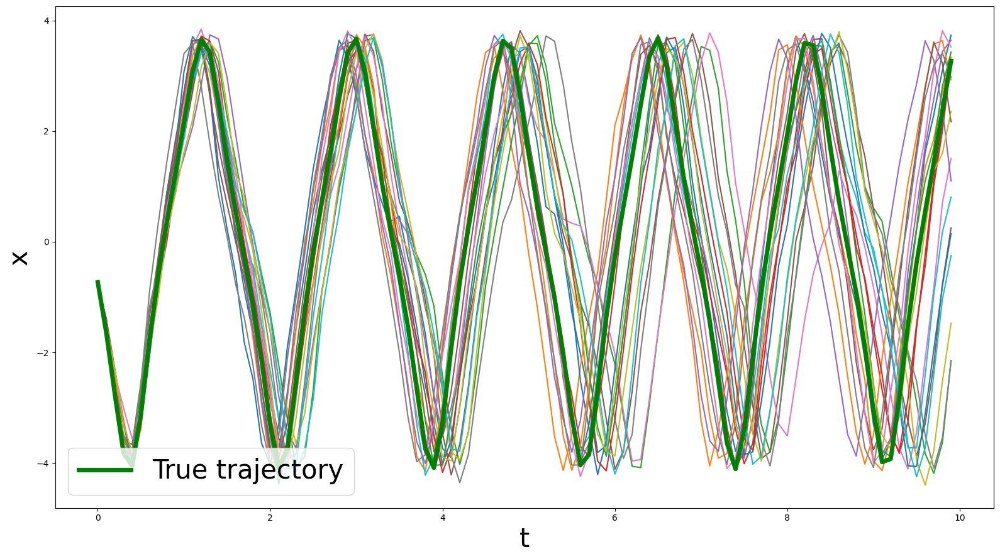

In [18]:
plt.figure(figsize=(16, 9))

# Рисуем графики
#for row, i in enumerate([0, 5, 9]):
for j in range(20):
    plt.plot(np.arange(0, 10, 0.1), all_matrices_predicts[9][j][:, 0][:100])
plt.plot(np.arange(0, 10, 0.1), test_trajectory_resampled[2501:2601, 0], label="True trajectory", color="Green", linewidth = 5)

#plt.title(str(1) + ' trajectory in training')
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.legend(fontsize=30)
plt.tight_layout()

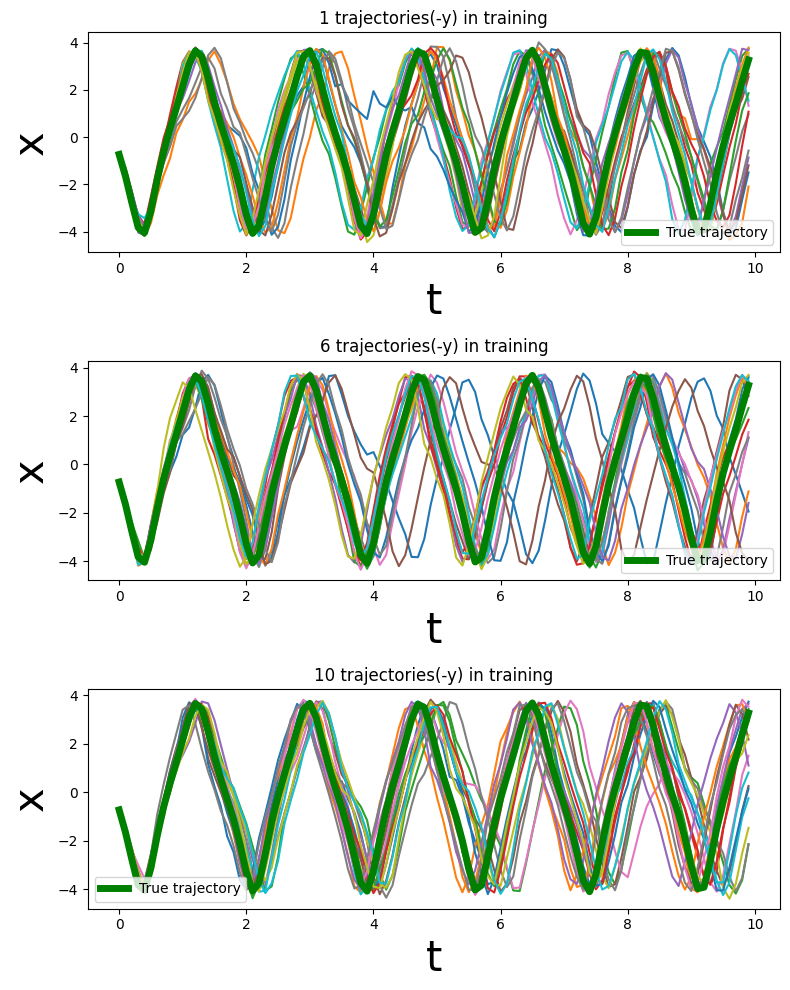

In [14]:
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(8, 10))

# Рисуем графики
for row, i in enumerate([0, 5, 9]):
    for j in range(20):
        axes[row].plot(np.arange(0, 10, 0.1), all_matrices_predicts[i][j][:, 0][:100])
    axes[row].plot(np.arange(0, 10, 0.1), test_trajectory_resampled[2501:2601, 0], label="True trajectory", color="Green", linewidth = 5)
    
    axes[row].set_title(str(i+1) + ' trajectories(-y) in training')
    axes[row].set_xlabel("t", fontsize=30)
    axes[row].set_ylabel("x", fontsize=30)
    axes[row].legend()
plt.tight_layout()

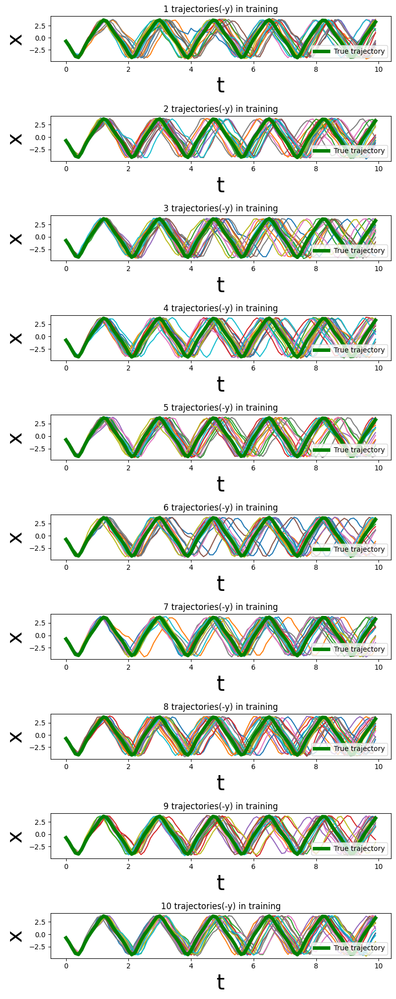

In [18]:
fig, axes = plt.subplots(nrows=10, ncols=1, figsize=(8, 20))

# Рисуем графики
for i in range(10):
    for j in range(20):
        axes[i].plot(np.arange(0, 10, 0.1), all_matrices_predicts[i][j][:, 0][:100])
    axes[i].plot(np.arange(0, 10, 0.1), test_trajectory_resampled[2501:2601, 0], label="True trajectory", color="Green", linewidth = 5)
    
    axes[i].set_title(str(i+1) + ' trajectories(-y) in training')
    axes[i].set_xlabel("t", fontsize=30)
    axes[i].set_ylabel("x", fontsize=30)
    axes[i].legend()
plt.tight_layout()

In [18]:
def ClosestMatrices(matrices, mode="Min"):
    min_value = 0
    if mode == "Min":
        min_value = 1e9
    closest_matrices = []   
    for index, matrix1 in enumerate(matrices):
        for matrix2 in matrices[index+1:]:
            distance = np.linalg.norm(matrix1 - matrix2)
            if (distance < min_value and mode == "Min") or (distance > min_value and mode != "Min"):
                min_value = distance
                closest_matrices = [matrix1, matrix2]
    return closest_matrices

## Близкие матрицы

In [34]:
matrix1, matrix2 = ClosestMatrices(loaded_matrices[0])
predict1 = ReservoirPredict(test_trajectory_resampled, reservoir, matrix1)
predict2 = ReservoirPredict(test_trajectory_resampled, reservoir, matrix2)


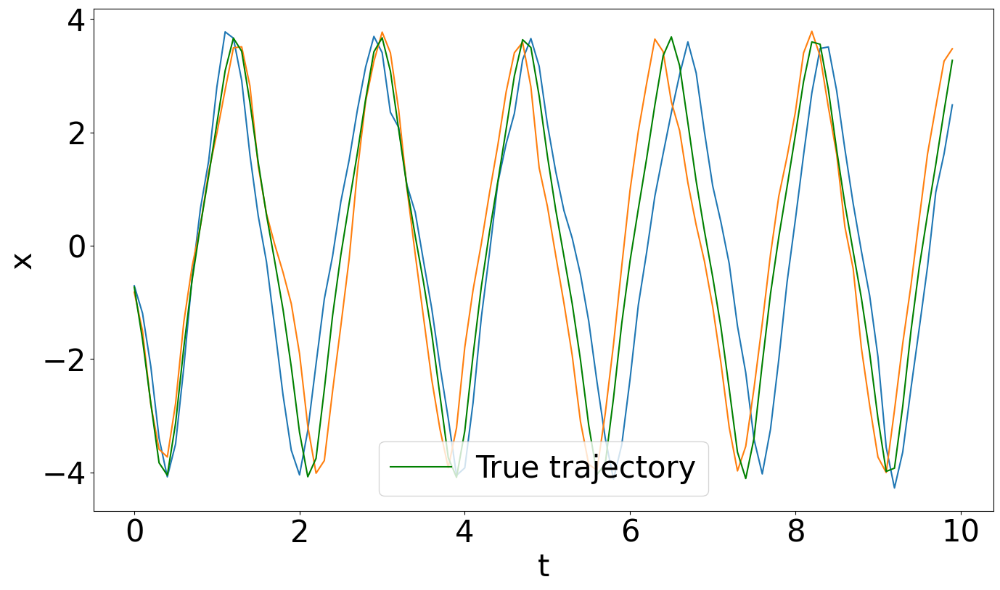

In [35]:
fig = plt.figure(figsize=(16, 9))

plt.plot(np.arange(0, 10, 0.1), predict1[:, 0][:100])
plt.plot(np.arange(0, 10, 0.1), predict2[:, 0][:100])

plt.plot(np.arange(0, 10, 0.1), test_trajectory_resampled[2501:2601, 0], label="True trajectory", color="Green")
    
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)

plt.legend(fontsize=30)

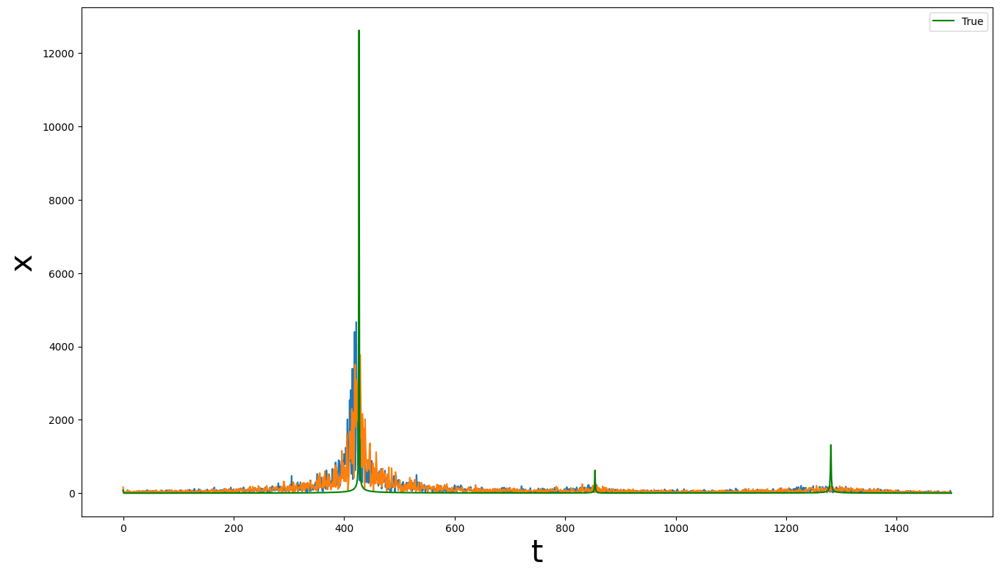

In [26]:
fig = plt.figure(figsize=(16, 9))
k = 1500

plt.plot(np.abs(np.fft.fft(predict1[:, 0]))[:k])
plt.plot(np.abs(np.fft.fft(predict2[:, 0]))[:k])

plt.plot(np.abs(np.fft.fft(test_trajectory_resampled[2501:, 0]))[:k], label="True", color="Green")
    
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.legend()

## Далекие матрицы

In [36]:
matrix1, matrix2 = ClosestMatrices(loaded_matrices[0], mode="Max")
predict1 = ReservoirPredict(test_trajectory_resampled, reservoir, matrix1)
predict2 = ReservoirPredict(test_trajectory_resampled, reservoir, matrix2)


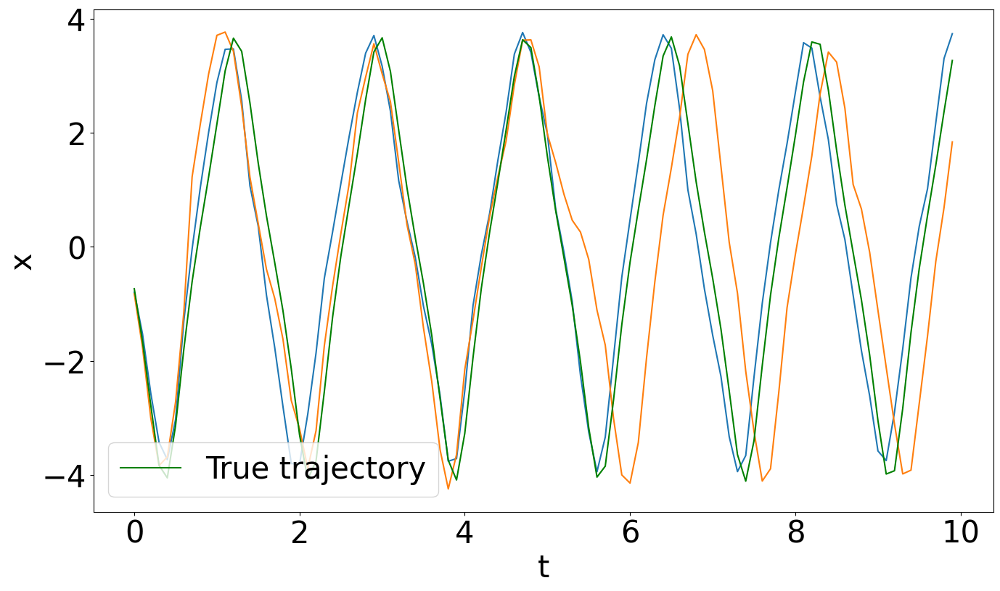

In [37]:
fig = plt.figure(figsize=(16, 9))

plt.plot(np.arange(0, 10, 0.1), predict1[:, 0][:100])
plt.plot(np.arange(0, 10, 0.1), predict2[:, 0][:100])

plt.plot(np.arange(0, 10, 0.1), test_trajectory_resampled[2501:2601, 0], label="True trajectory", color="Green")
    
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)

plt.legend(fontsize=30)

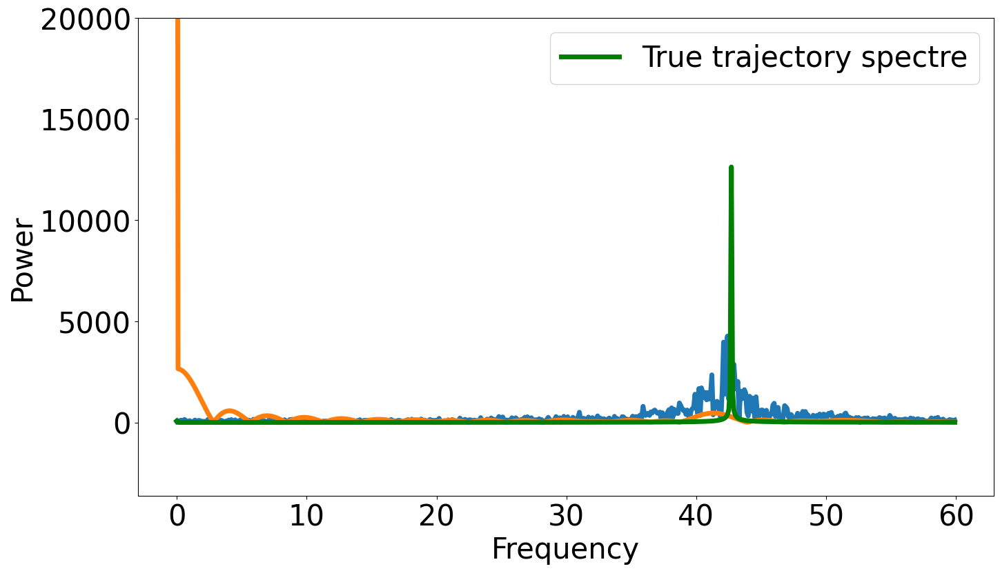

In [43]:
fig = plt.figure(figsize=(16, 9))
k = 600

plt.plot(np.arange(0, k // 10, 0.1), np.abs(np.fft.fft(predict1[:, 0]))[:k], linewidth=5)
plt.plot(np.arange(0, k // 10, 0.1), np.abs(np.fft.fft(predict2[:, 0]))[:k], linewidth=5)

plt.plot(np.arange(0, k // 10, 0.1), np.abs(np.fft.fft(test_trajectory_resampled[2501:, 0]))[:k], label="True trajectory spectre", 
         color="Green", linewidth=5)
    
plt.xlabel("Frequency", fontsize=30)
plt.ylabel("Power", fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)

plt.ylim(top=20000)
plt.legend(fontsize=30)

## Для обучения по 2-м траекториям

### Близкие матрицы

In [41]:
matrix1, matrix2 = ClosestMatrices(loaded_matrices[1])
predict1 = ReservoirPredict(test_trajectory_resampled, reservoir, matrix1)
predict2 = ReservoirPredict(test_trajectory_resampled, reservoir, matrix2)


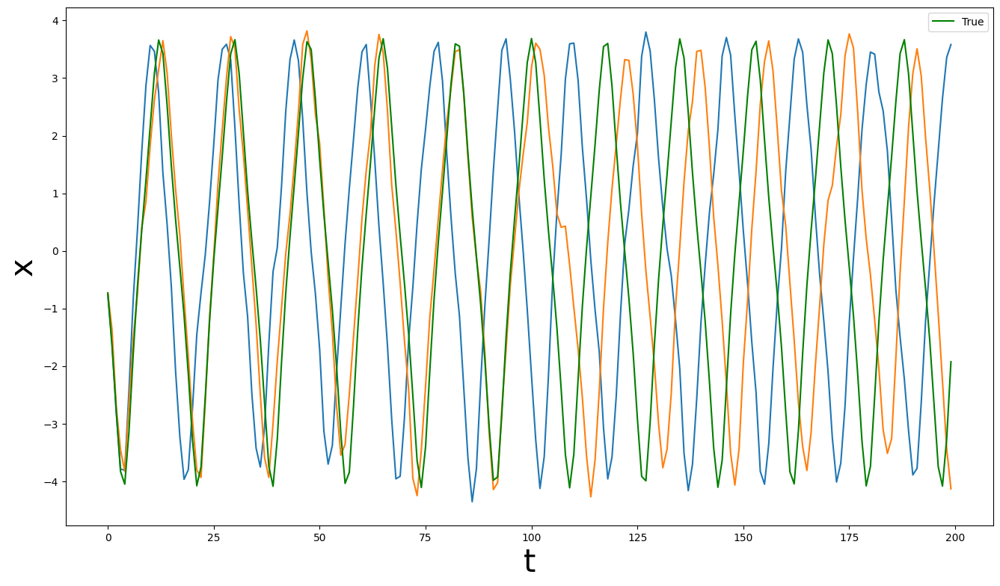

In [42]:
fig = plt.figure(figsize=(16, 9))

plt.plot(predict1[:, 0][:200])
plt.plot(predict2[:, 0][:200])

plt.plot(test_trajectory_resampled[2501:2701, 0], label="True", color="Green")
    
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.legend()

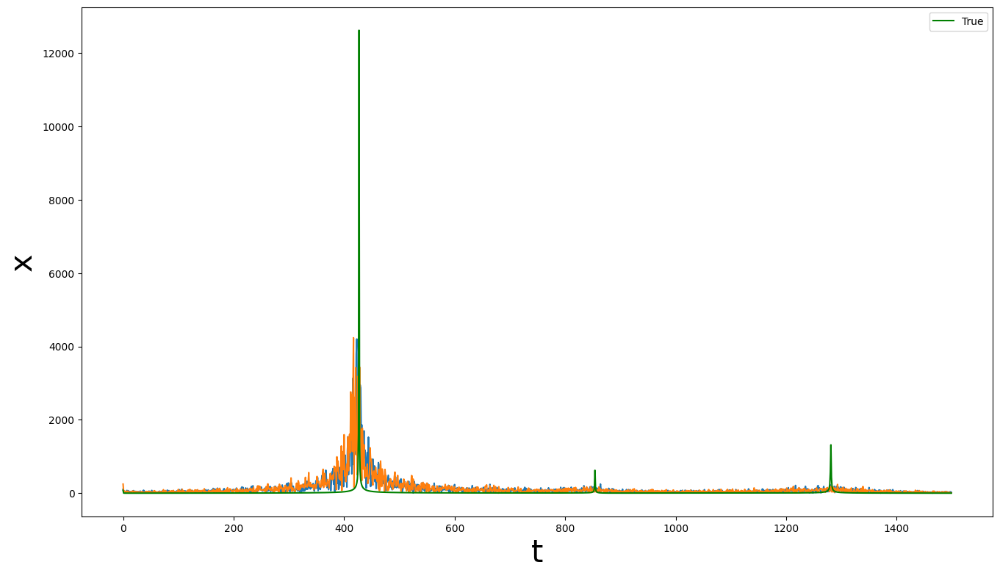

In [43]:
fig = plt.figure(figsize=(16, 9))
k = 1500

plt.plot(np.abs(np.fft.fft(predict1[:, 0]))[:k])
plt.plot(np.abs(np.fft.fft(predict2[:, 0]))[:k])

plt.plot(np.abs(np.fft.fft(test_trajectory_resampled[2501:, 0]))[:k], label="True", color="Green")
    
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.legend()

### Далекие матрицы

In [44]:
matrix1, matrix2 = ClosestMatrices(loaded_matrices[1], mode="Max")
predict1 = ReservoirPredict(test_trajectory_resampled, reservoir, matrix1)
predict2 = ReservoirPredict(test_trajectory_resampled, reservoir, matrix2)


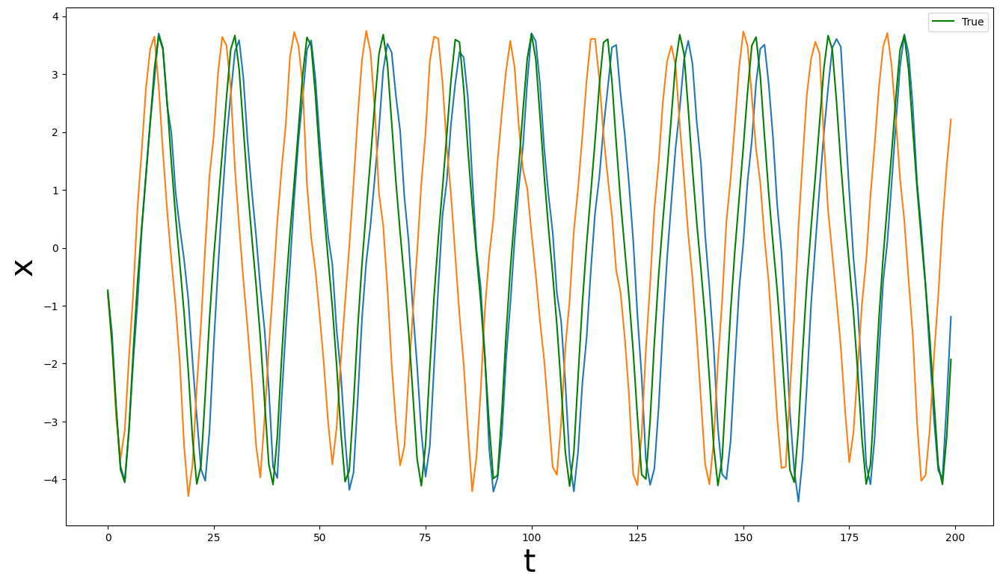

In [45]:
fig = plt.figure(figsize=(16, 9))

plt.plot(predict1[:, 0][:200])
plt.plot(predict2[:, 0][:200])

plt.plot(test_trajectory_resampled[2501:2701, 0], label="True", color="Green")
    
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.legend()

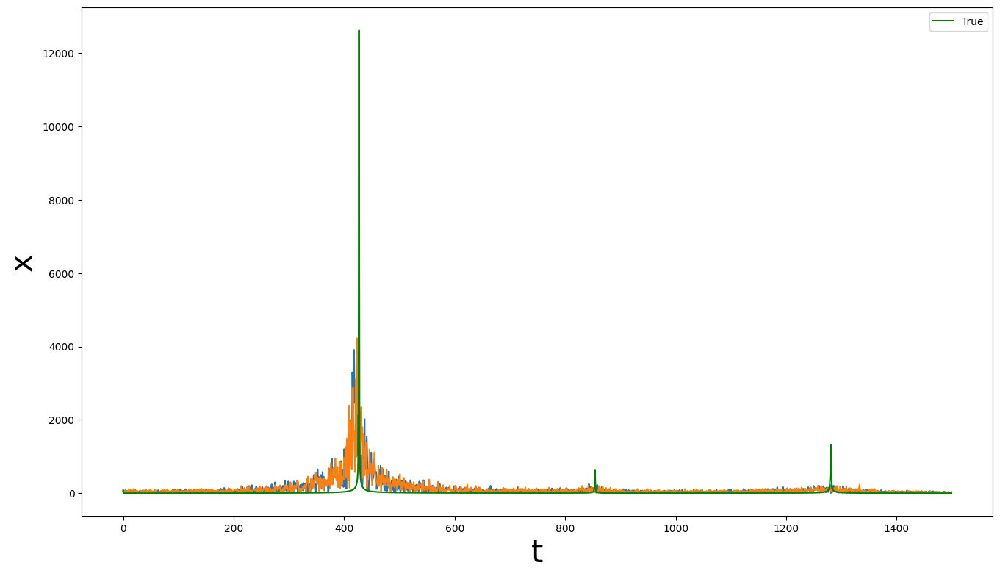

In [46]:
fig = plt.figure(figsize=(16, 9))
k = 1500

plt.plot(np.abs(np.fft.fft(predict1[:, 0]))[:k])
plt.plot(np.abs(np.fft.fft(predict2[:, 0]))[:k])

plt.plot(np.abs(np.fft.fft(test_trajectory_resampled[2501:, 0]))[:k], label="True", color="Green")
    
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.legend()

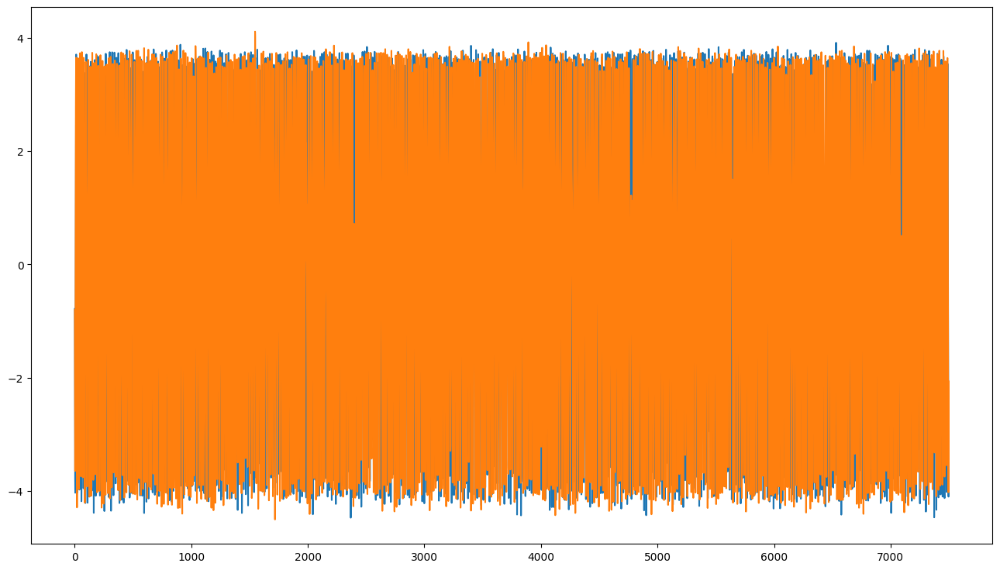

In [47]:
fig = plt.figure(figsize=(16, 9))

plt.plot(predict1[:, 0])
plt.plot(predict2[:, 0])

## Есть ли смена режима на обучении с большим числом траекторий

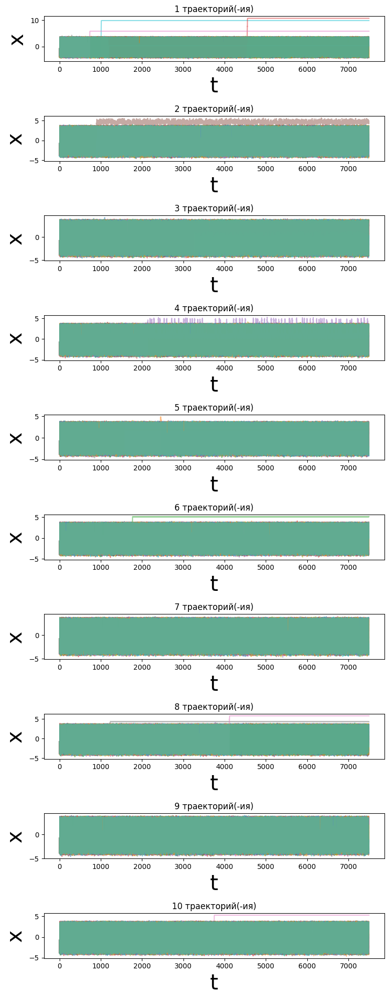

In [48]:
fig, axes = plt.subplots(nrows=10, ncols=1, figsize=(8, 20))

# Рисуем графики
for i in range(10):
    for j in range(20):#range(len(all_matrices_predicts[i])):
        axes[i].plot(all_matrices_predicts[i][j][:, 0], alpha=0.5)
    #axes[i].plot(test_trajectory_resampled[2501:, 0], label="True", color="Green", linewidth = 5)
    
    axes[i].set_title(str(i+1) + ' траекторий(-ия)')
    axes[i].set_xlabel("t", fontsize=30)
    axes[i].set_ylabel("x", fontsize=30)
    #axes[i].legend()
plt.tight_layout()

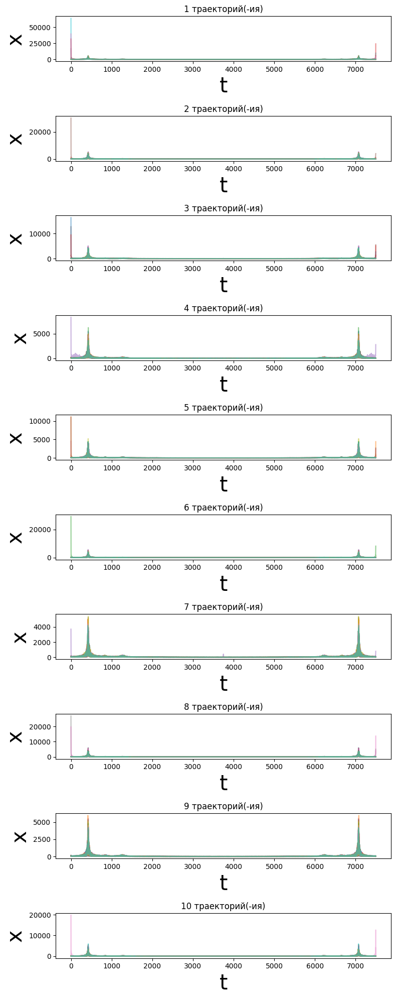

In [49]:
fig, axes = plt.subplots(nrows=10, ncols=1, figsize=(8, 20))

# Рисуем графики
for i in range(10):
    for j in range(20):#range(len(all_matrices_predicts[i])):
        axes[i].plot(np.abs(np.fft.fft(all_matrices_predicts[i][j][:, 0])), alpha=0.5)
    #axes[i].plot(test_trajectory_resampled[2501:, 0], label="True", color="Green", linewidth = 5)
    
    axes[i].set_title(str(i+1) + ' траекторий(-ия)')
    axes[i].set_xlabel("t", fontsize=30)
    axes[i].set_ylabel("x", fontsize=30)
    #axes[i].legend()
plt.tight_layout()

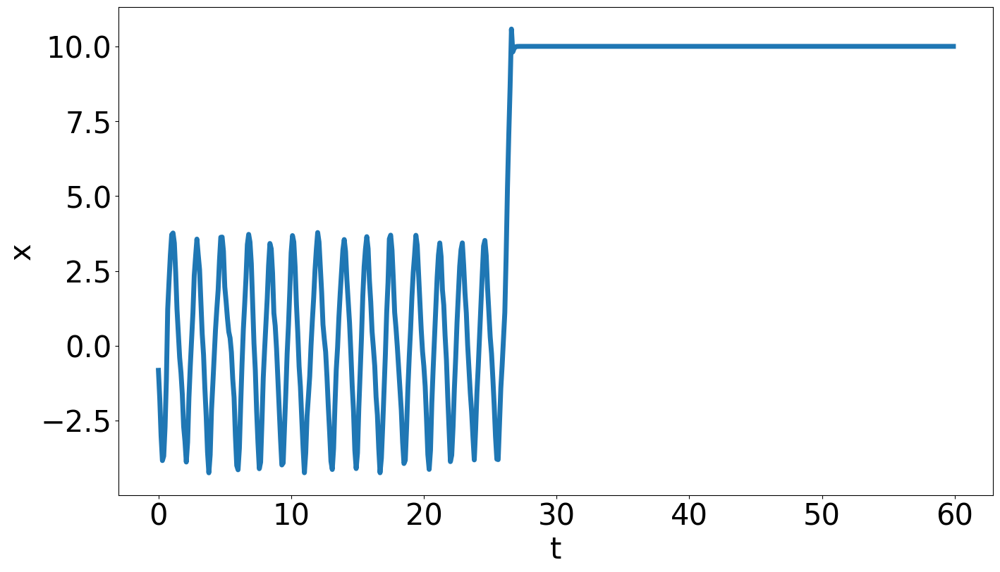

In [52]:
fig = plt.figure(figsize=(16, 9))

plt.plot(np.arange(0, 60, 0.1),predict2[:600, 0], linewidth=5)

    
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)



In [87]:
all_change = []
for i in range(10):
    c = 0
    for j in range(20):
        if (np.abs(np.fft.fft(all_matrices_predicts[i][j][:, 0]))[:10] > 1000).any():
            c += 1
    all_change.append(c)

## Количество траекторий, которые переключили режим

Text(0.5, 0, 'Number of trajectories in training')

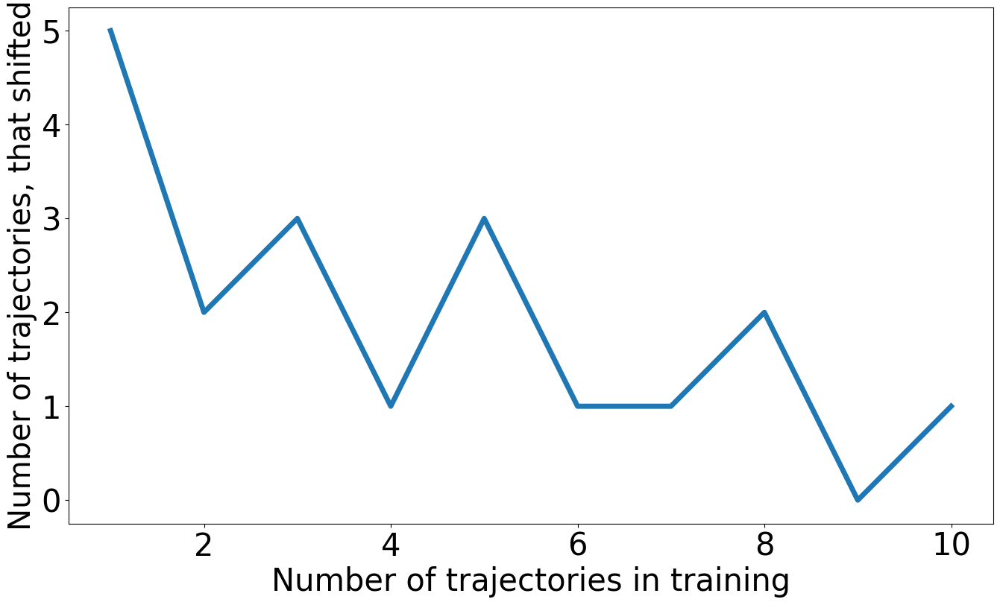

In [92]:
plt.figure(figsize=(16, 9))
plt.plot(np.arange(1, 11), all_change, linewidth=5)#plt.bar(np.arange(1, 11), all_change, width=1)
plt.tick_params(axis='both', which='major', labelsize=30)

plt.ylabel("Number of trajectories, that shifted", fontsize=29)
plt.xlabel("Number of trajectories in training", fontsize=30)


## MSE на спектре и на временных рядах

In [3]:
def CalculateMSE(all_predicts, test_trajectory, mode="time"):
    means = []
    stds = []
    mses = []
    for step_trajectorys in all_predicts:
        current_mses = []
        for trajectory in step_trajectorys:
            mse = None
            if mode == "time":
                mse = np.mean((np.array(trajectory) - np.array(test_trajectory)) ** 2)
            else:
                assert np.abs(np.fft.fft(trajectory)).shape == trajectory.shape
                mse = np.mean(((np.abs(np.fft.fft(trajectory))) - np.abs(np.fft.fft((test_trajectory)))) ** 2)
            current_mses.append(mse)
        means.append(np.mean(current_mses))
        stds.append(np.std(current_mses))
        mses.append(current_mses)
    return np.array(means), np.array(stds), mses

In [9]:
means, stds, mses = CalculateMSE(all_matrices_predicts, test_trajectory_resampled[2501:])

In [17]:
print("min mse 1:", np.min(mses[0]), "max mse 1:", np.max(mses[0]))

min mse 1: 36.11024776089648 max mse 1: 559.9213491212179


In [16]:
print("min mse 10:", np.min(mses[9]), "max mse 10:", np.max(mses[9]))



min mse 10: 36.33121084036311 max mse 10: 77.84926785208158


In [79]:
perc10 = [np.percentile(mses[i], 10) for i in range(len(mses))]
perc90 = [np.percentile(mses[i], 90) for i in range(len(mses))]


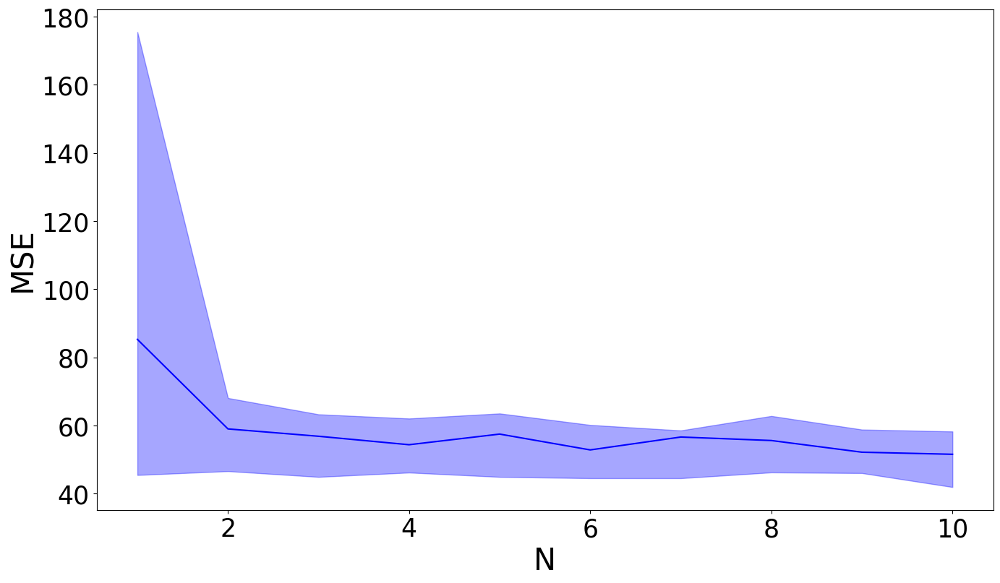

In [80]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot()
ax.plot(np.arange(1, 11), means, color="blue")
ax.fill_between(np.arange(1, 11), perc10, perc90, alpha=0.35, color="blue")

ax.set_xlabel("N", size=30)
ax.set_ylabel("MSE", size=30)
ax.tick_params(axis='both', which='major', labelsize=25)

In [83]:
means, stds, mses = CalculateMSE(all_matrices_predicts, test_trajectory_resampled[2501:], mode="fft")

In [84]:
perc10 = [np.percentile(mses[i], 10) for i in range(len(mses))]
perc90 = [np.percentile(mses[i], 90) for i in range(len(mses))]


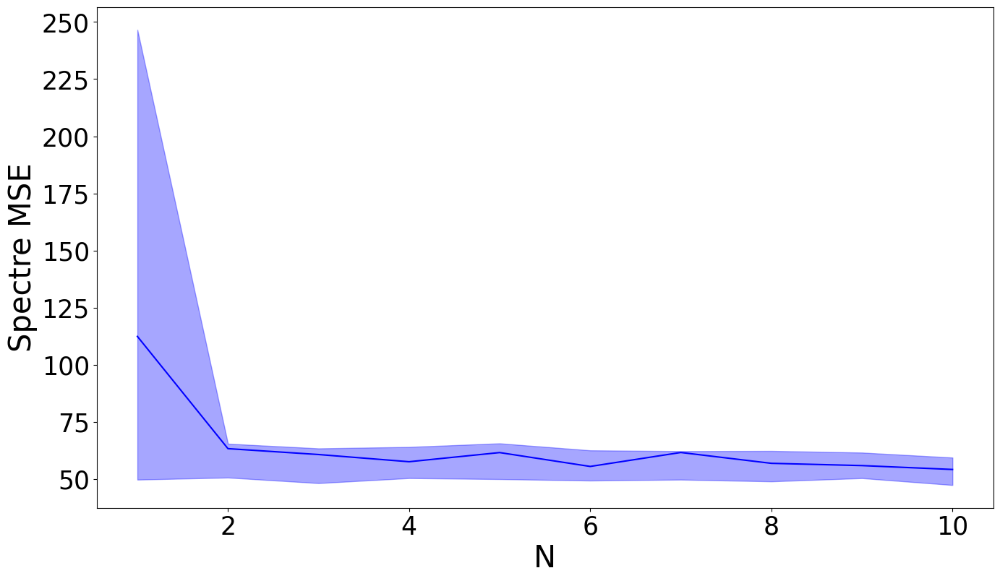

In [86]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot()
ax.plot(np.arange(1, 11), means, color="blue")
ax.fill_between(np.arange(1, 11), perc10, perc90, alpha=0.35, color="blue")

ax.set_xlabel("N", size=30)
ax.set_ylabel("Spectre MSE", size=30)
ax.tick_params(axis='both', which='major', labelsize=25)

Проверка правильности предсказания резервуара

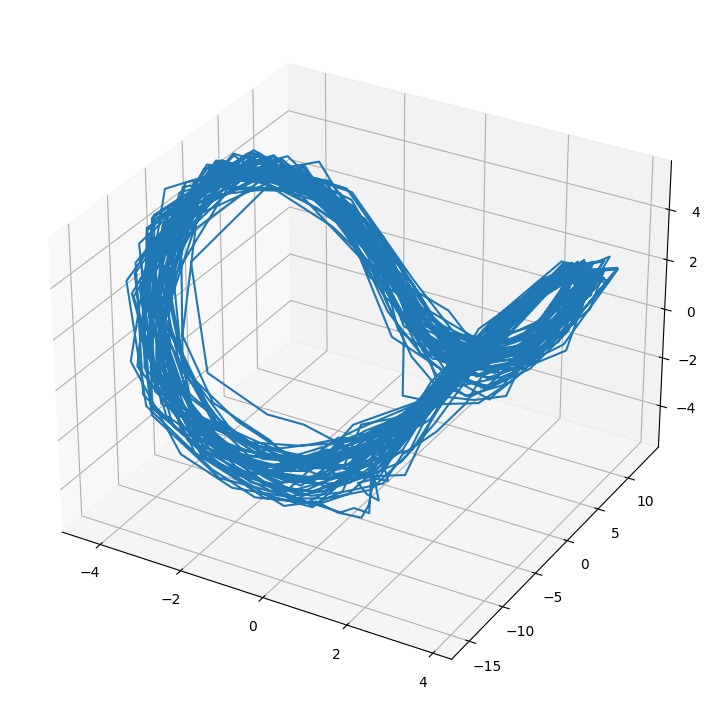

In [38]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot(projection='3d')
ax.plot(predicts[:, 0][:1000], predicts[:, 1][:1000], predicts[:, 2][:1000])

# Просмотр на двух траекториях

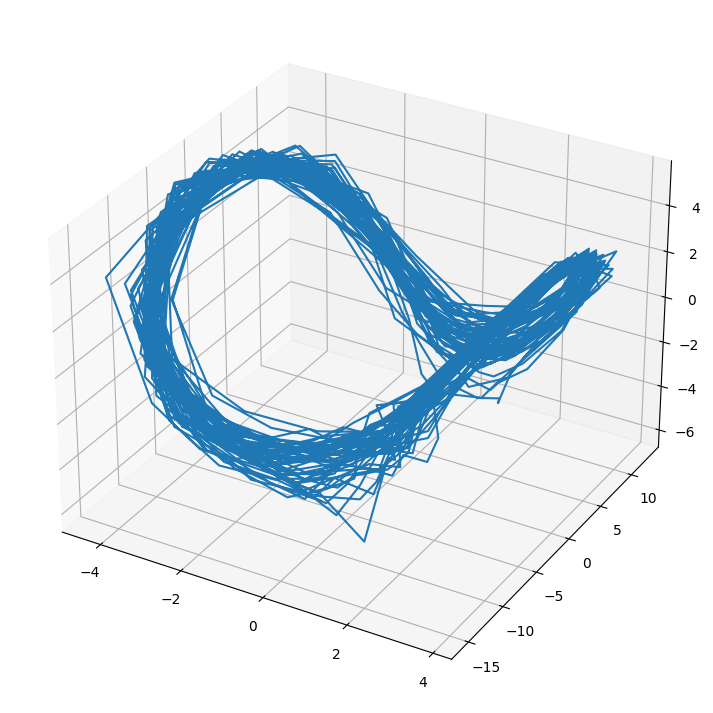

In [50]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot(projection='3d')
ax.plot(predicts[:, 0, 0][:1000], predicts[:, 0, 1][:1000], predicts[:, 0, 2][:1000])

In [66]:
predicts2 = ReservoirPredict(trajectorys[1].T, reservoir)


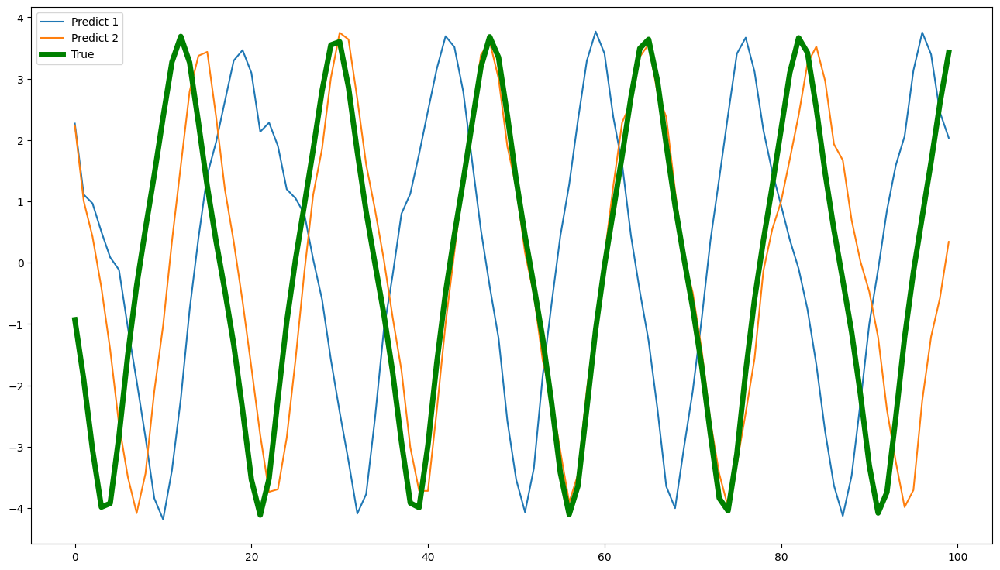

In [68]:
plt.figure(figsize=(16, 9))
plt.plot(predicts[:, 0, 0][:100], label="Predict 1")
plt.plot(predicts2[:, 0, 0][:100], label="Predict 2")
plt.plot(trajectorys[1][0][::10][2501:2601], label="True", color="Green", linewidth = 5)
plt.legend()

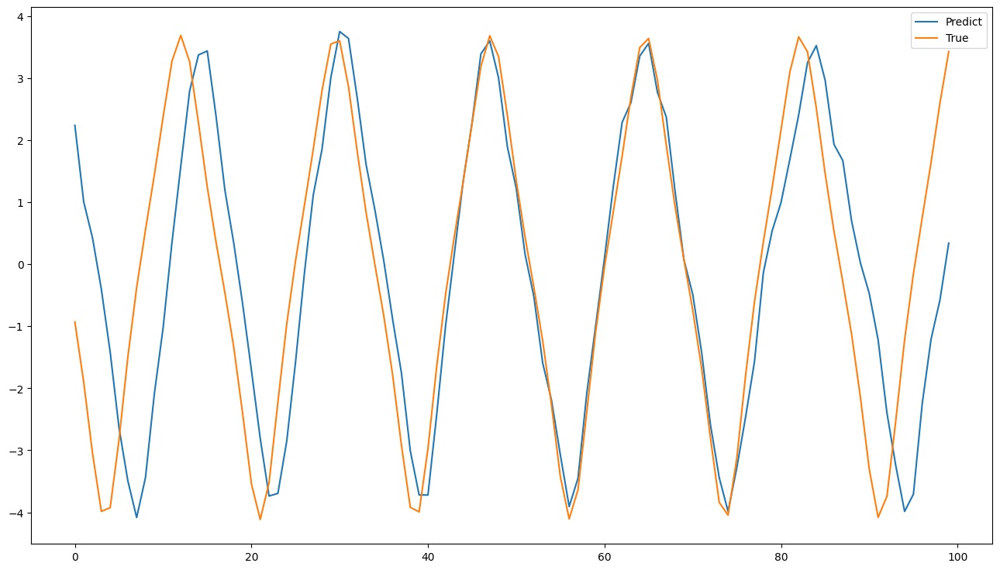

In [65]:
plt.figure(figsize=(16, 9))
plt.plot(predicts2[:, 0, 0][:100], label="Predict")
plt.plot(trajectorys[1][0][::10][2501:2601], label="True")
plt.legend()

# Rossler

In [ ]:
def CalculateMatricesStandartReservoir(train_parts, test_parts, plot_3d=False, name="Rossler", method="reservoir"):
    all_matrices = []
    rpy.set_seed(42)
    reservoir = Reservoir(200, lr=0.5, sr=0.9)
    for i in range(1, 11):
        print("Шаг: ", i + 1)
        matrices = []
        for j in tqdm(range(0, 100-i, i)):
            X = train_parts[j:j+i]
            Y_train = []
            all_states = []
            for c in range(i):
                X_train = X[c][:-1]
                Y_train.append(X[c][1:])
                rpy.set_seed(42)
                reservoir.reset()
                if plot_3d:
                    states = reservoir.run(X_train)
                    all_states.append(states)
                else:
                    states = reservoir.run(X_train[..., None])
                    all_states.append(states)


            readout = Ridge(ridge=1e-7, input_bias=False)
            states = np.concatenate(all_states)
            Y_train = np.concatenate(Y_train)
    #         print("states", states.shape)
    #         print("Y_train", Y_train.shape)

            if plot_3d:
                readout.fit(states, Y_train)
            else:
                readout.fit(states[1000:], Y_train[..., None][1000:])
                
            matrices.append(readout.params["Wout"])


            if j + 2 * i >= 100:
                

                if not plot_3d:
                    X_test = test_parts[-1][:-1][..., None]
                    Y_test = test_parts[-1][1:][..., None][100:]
                    states = reservoir.run(X_test, reset=True)[100:]
                    output = readout.run(states)
                    fig = plt.figure(figsize=(16, 9))
                    ax = fig.add_subplot()
                    ax.plot(Y_test, color="blue", label="True values", linewidth = 5)
                    ax.plot(output, color="red", linestyle = '--', label="Predicted values", linewidth = 5)

                    ax.set_xlabel("t", size=30)
                    ax.set_ylabel("x", size=30)
                    ax.tick_params(axis='both', which='major', labelsize=16)
                    #ax.set_title(f"Reservoir prediction of the x variable example with {i} trajectories in training", size=30)
                    ax.legend(fontsize=20)
                else:
                    X_test = test_parts[-1][:-1]
                    Y_test = test_parts[-1][1:][100:]
                    states = reservoir.run(X_test, reset=True)[100:]
                    output = readout.run(states)
                    fig = plt.figure(figsize=(16, 9))
                    ax = fig.add_subplot(projection='3d')
                    ax.plot(Y_test[:, 0], Y_test[:, 1], Y_test[:, 2], color="blue", label="True values")
                    ax.plot(output[:, 0], output[:, 1], output[:, 2], linestyle = '--', alpha=0.35, color="red", label="Predicted values")
                    ax.set_xlabel("x", size=30, labelpad=20)
                    ax.set_ylabel("y", size=30, labelpad=20)
                    ax.set_zlabel("z", size=30, labelpad=20)
                    ax.set_box_aspect(None, zoom=0.85)
                    ax.tick_params(axis='both', which='major', labelsize=16)
                    #ax.set_title(f"Reservoir prediction of the {name} system example with {i} trajectories in training", size=30)
                    ax.legend(fontsize=20)

        all_matrices.append(matrices)
    return all_matrices

In [8]:
def CalculateDistance(v1, v2):
    return np.sqrt((v1 - v2)**2)

In [3]:
def CalculateMeanStdNotAutoreg(all_matrices, frobenius=False):
    means = []
    stds = []
    all_distances = []
    for matrices in all_matrices:
        distances = []
        for index, matrix1 in enumerate(matrices):
            for matrix2 in matrices[index+1:]:
                distance = np.linalg.norm(matrix1 - matrix2) if frobenius else CalculateDistance(matrix1, matrix2)
                distances.append(distance)
        means.append(np.mean(distances))
        stds.append(np.std(distances))  
        all_distances.append(distances)
    return np.array(means), np.array(stds), all_distances

In [111]:
trajectorys = []
for i in range(100):
    trajectorys.append(np.load("data/rossler0_1Step"+str(i) + ".npy"))

In [129]:
train_parts = []
test_parts = []
for trajectory in trajectorys:
    train_parts.append(trajectory[:, :8000].T)
    test_parts.append(trajectory[:, 8000:].T)    

  0%|          | 0/10 [00:00<?, ?it/s]

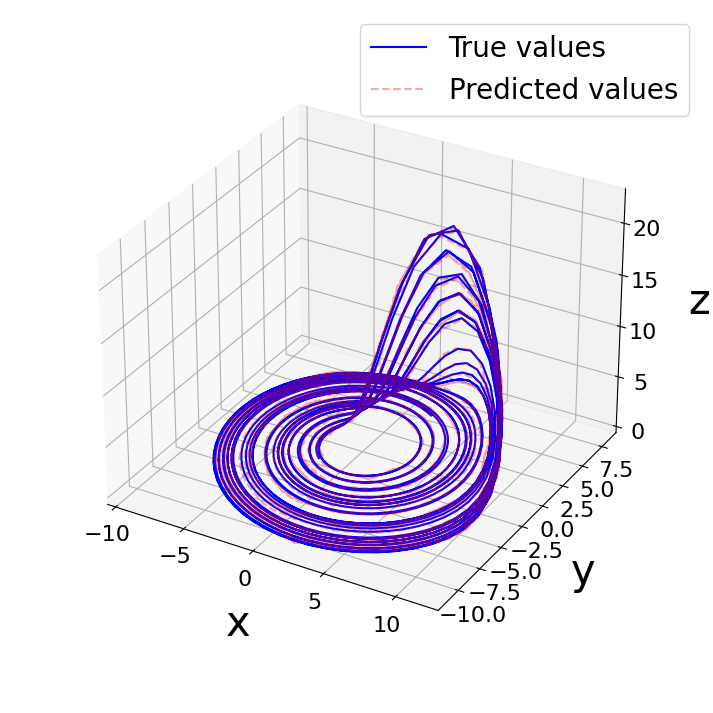

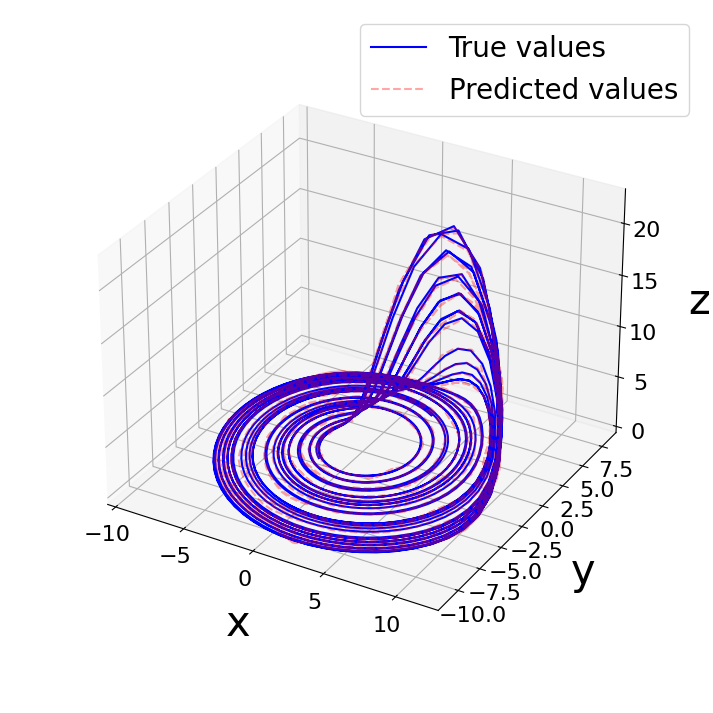

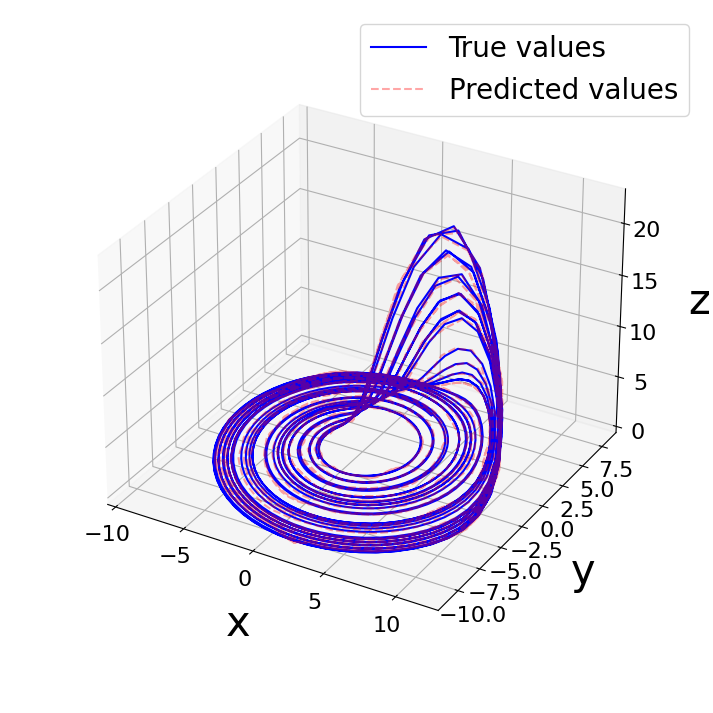

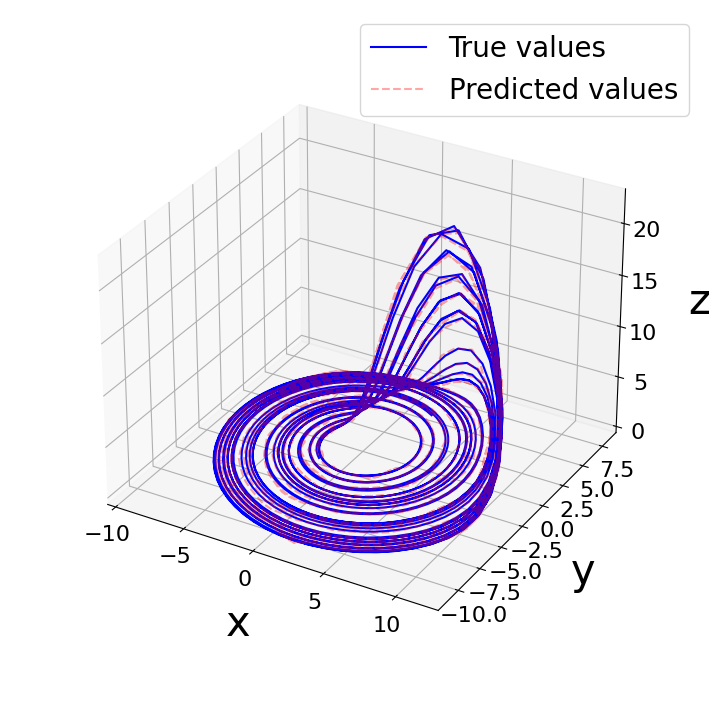

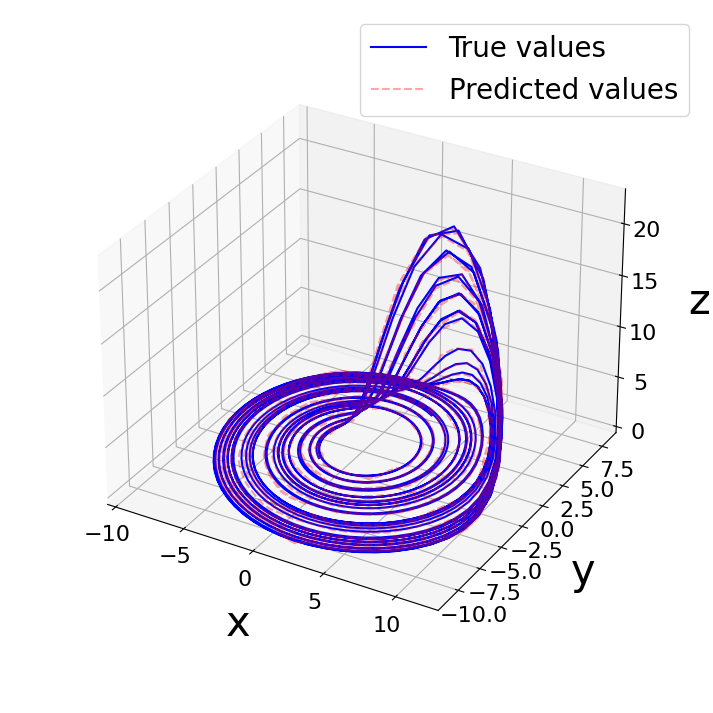

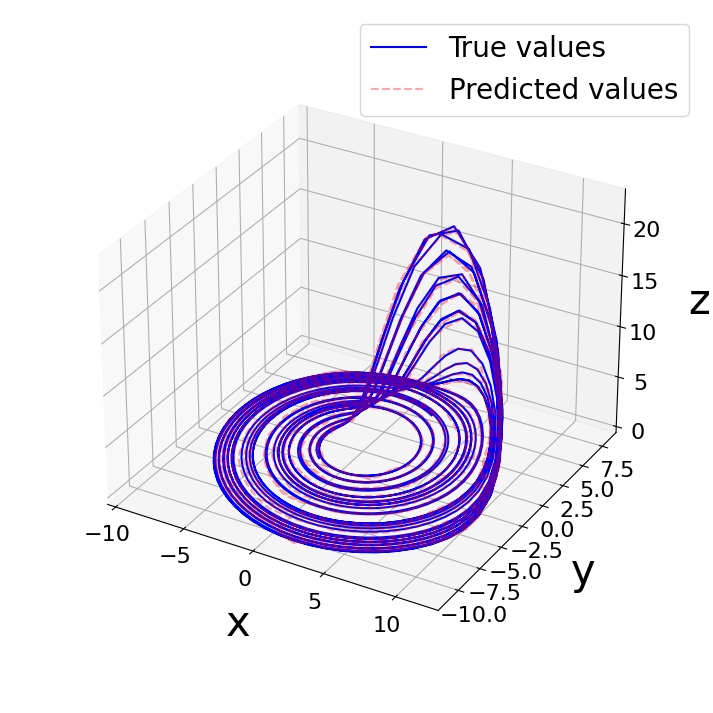

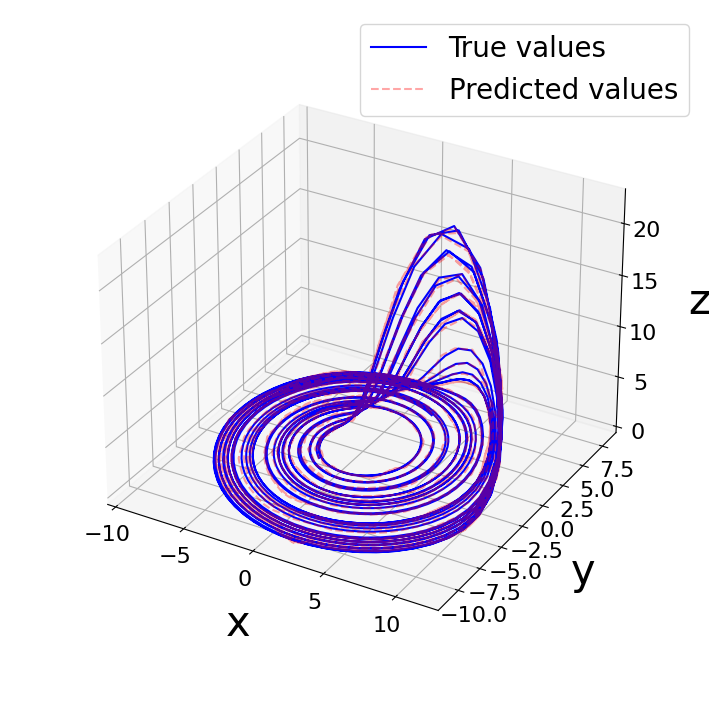

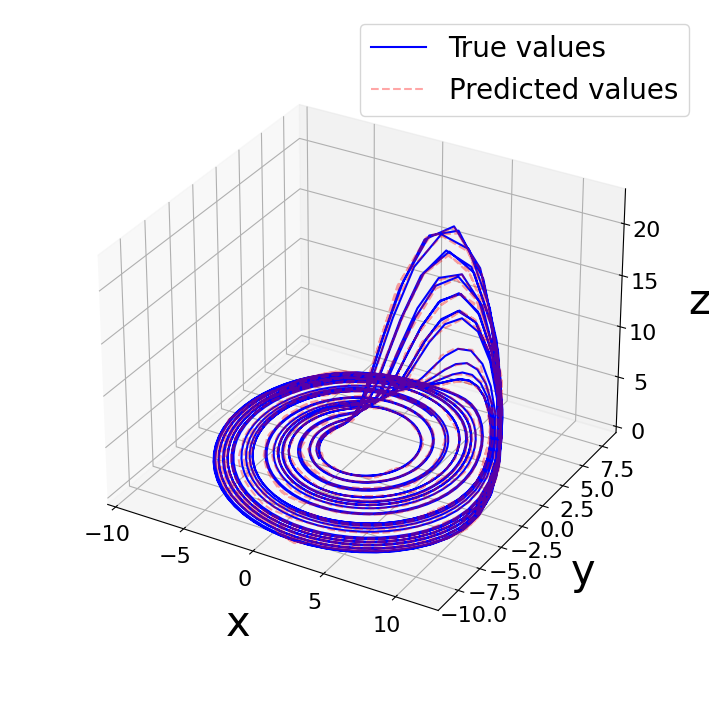

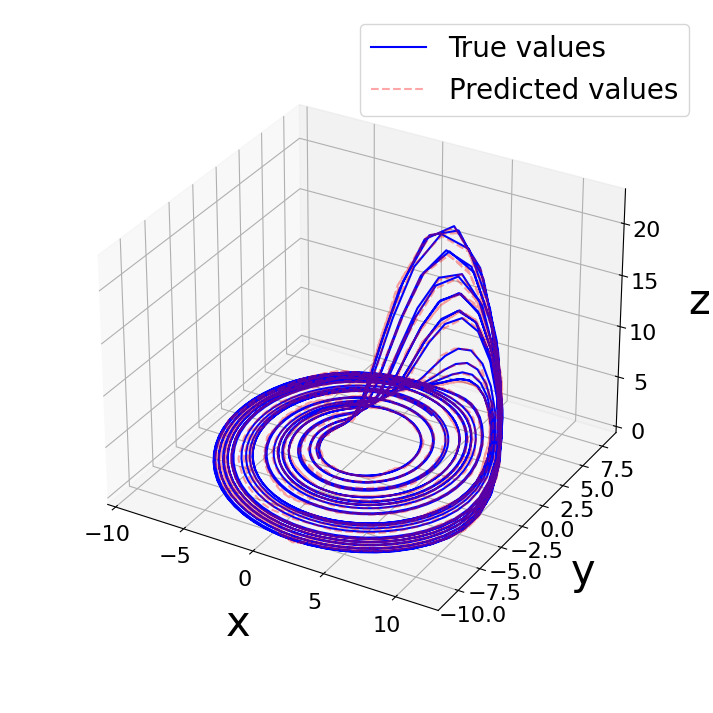

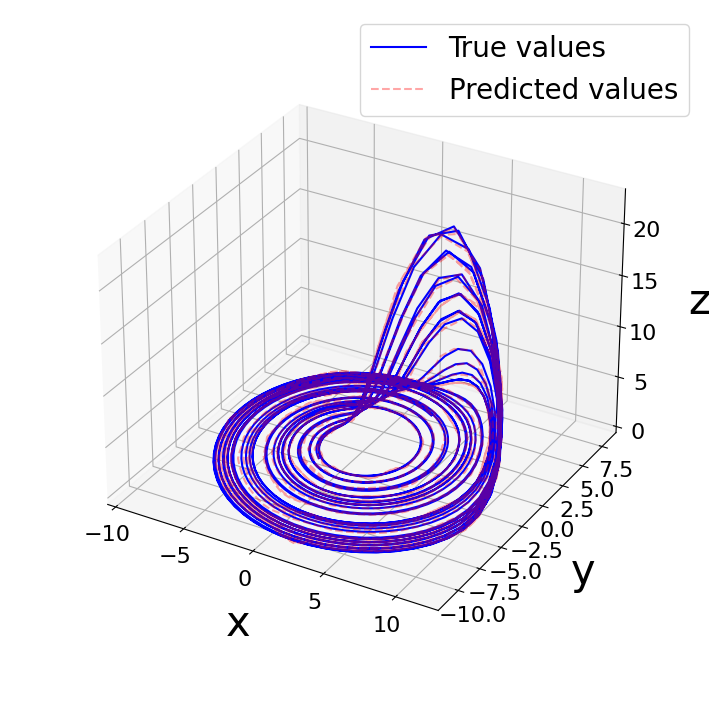

In [130]:
all_matrices = CalculateMatrices(train_parts, test_parts, plot_3d=True)

In [ ]:
#np.savez("predicts/all_matricesRossler.npz", *all_matrices)


In [7]:
loaded_data = np.load("predicts/all_matricesRossler.npz")
all_matrices = [loaded_data[f'arr_{i}'] for i in range(len(loaded_data.files))]

In [146]:
def ReservoirPredictRossler(trajectory, reservoir, Wout):
    rpy.set_seed(42)
    reservoir.reset()
    warmap_states = reservoir.run(trajectory[:, :1000].T)
    Y_pred = []
    for i in range(trajectory.shape[1] - 1000):

        state = reservoir(trajectory[:, 1000 + i])
        output = state @ Wout
        Y_pred.append(output)
        
    return np.array(Y_pred)

In [24]:
a = b = 0.2
c = 5.7
def Rossler(t, X):
    x, y, z = X
    return [- y - z,
            x + a * y,
            b + z * (x - c)]

In [25]:
test_trajectory  = solve_ivp(Rossler, [0, 1000], 
                    [np.random.uniform(-0.1, 0.1), np.random.uniform(-0.1, 0.1), np.random.uniform(-0.1, 0.1)], 
                    t_eval=np.arange(0, 1000, 0.1), rtol = 1e-11, atol = 1e-11, dense_output=True).y

In [143]:

rpy.verbosity(0)  # no need to be too verbose here
rpy.set_seed(42)
reservoir = Reservoir(200, lr=0.5, sr=0.9)
verbosity(0)
predicts = ReservoirPredictRossler(test_trajectory, reservoir, all_matrices[0][0])

(1000, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200)
(1, 200

In [33]:
plt.plot(predicts[:1000, 0, 0])
plt.plot(test_trajectory[0, 1001:2001])


IndexError: too many indices for array: array is 2-dimensional, but 3 were indexed

In [147]:
rpy.set_seed(42)
reservoir = Reservoir(200, lr=0.5, sr=0.9)
verbosity(0)

all_matrices_predicts = []
for i in tqdm(range(len(all_matrices))):
    current_matrices_predicts = []
    for j in range(len(all_matrices[i])):
        predicts = ReservoirPredictRossler(test_trajectory, reservoir, all_matrices[i][j])
        current_matrices_predicts.append(predicts)
    all_matrices_predicts.append(current_matrices_predicts)

  0%|          | 0/10 [00:00<?, ?it/s]

In [148]:
all_matrices_predicts[0][0].shape

(9000, 1, 3)

In [ ]:
#np.savez("predicts/all_matrices_predictsRosslerFull.npz", *all_matrices_predicts)

In [22]:
loaded_data = np.load("predicts/all_matrices_predictsRosslerFull.npz")
all_matrices_predicts = [loaded_data[f'arr_{i}'] for i in range(len(loaded_data.files))]

## Отрисовка

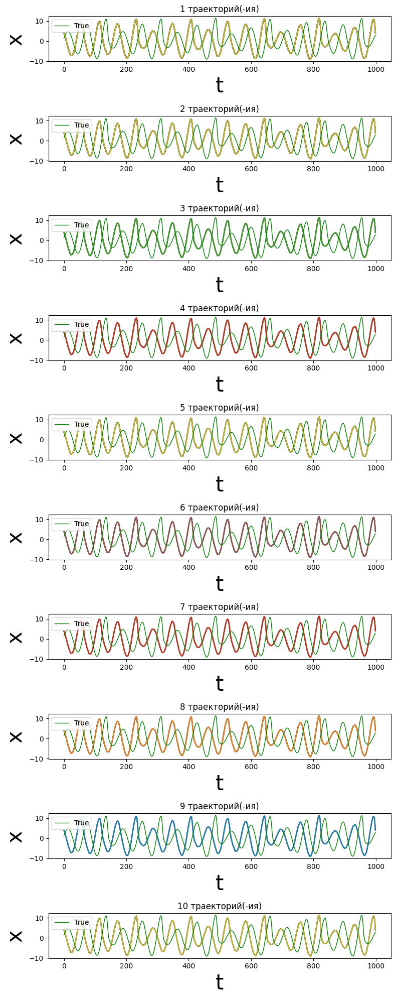

In [29]:
fig, axes = plt.subplots(nrows=10, ncols=1, figsize=(8, 20))

# Рисуем графики
for i in range(10):
    for j in range(len(all_matrices_predicts[i])):
        axes[i].plot(all_matrices_predicts[i][j][:, :, 0][:1000])
    axes[i].plot(test_trajectory[0, 1001:2001], label="True", color="Green", linewidth = 1)
    
    axes[i].set_title(str(i+1) + ' траекторий(-ия)')
    axes[i].set_xlabel("t", fontsize=30)
    axes[i].set_ylabel("x", fontsize=30)
    axes[i].legend()
plt.tight_layout()

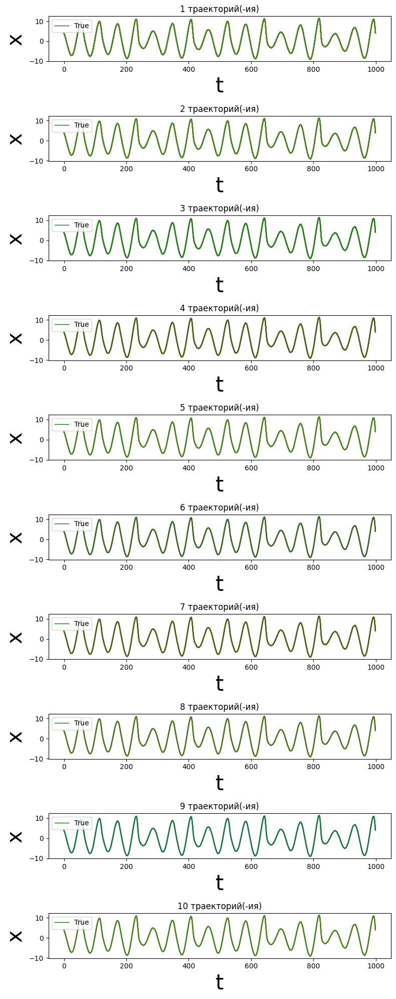

In [151]:
fig, axes = plt.subplots(nrows=10, ncols=1, figsize=(8, 20))

# Рисуем графики
for i in range(10):
    for j in range(len(all_matrices_predicts[i])):
        axes[i].plot(all_matrices_predicts[i][j][:, :, 0][:1000])
    axes[i].plot(test_trajectory[0, 1001:2001], label="True", color="Green", linewidth = 1)
    
    axes[i].set_title(str(i+1) + ' траекторий(-ия)')
    axes[i].set_xlabel("t", fontsize=30)
    axes[i].set_ylabel("x", fontsize=30)
    axes[i].legend()
plt.tight_layout()

## Близкие матрицы

In [162]:
matrix1, matrix2 = ClosestMatrices(all_matrices[1])
predict1 = ReservoirPredictRossler(test_trajectory, reservoir, matrix1)
predict2 = ReservoirPredictRossler(test_trajectory, reservoir, matrix2)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


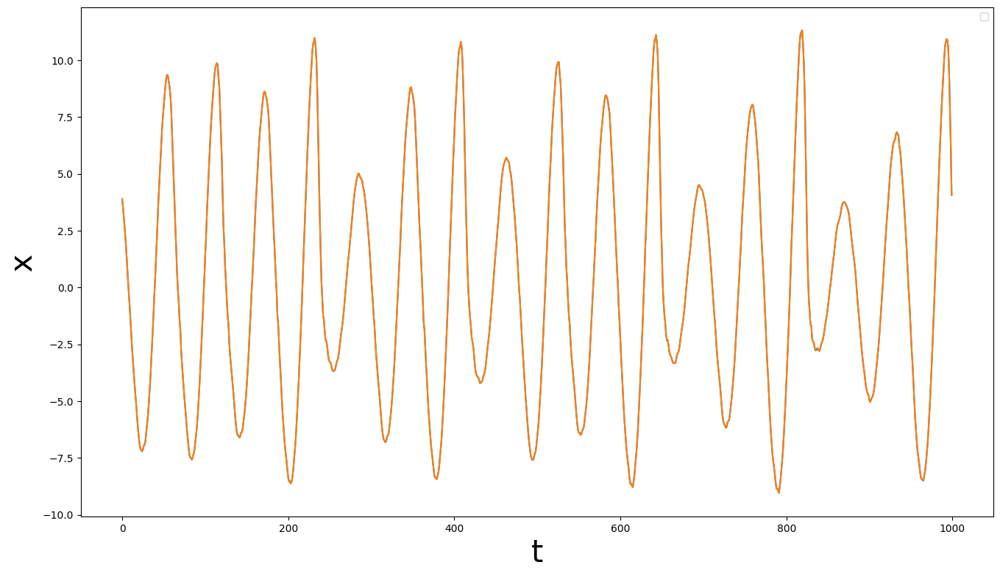

In [163]:
fig = plt.figure(figsize=(16, 9))

plt.plot(predict1[:, :, 0][:1000])
plt.plot(predict2[:, :, 0][:1000])

#plt.plot(test_trajectory[0, 1001:2101], label="True", color="Green")
    
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.legend()

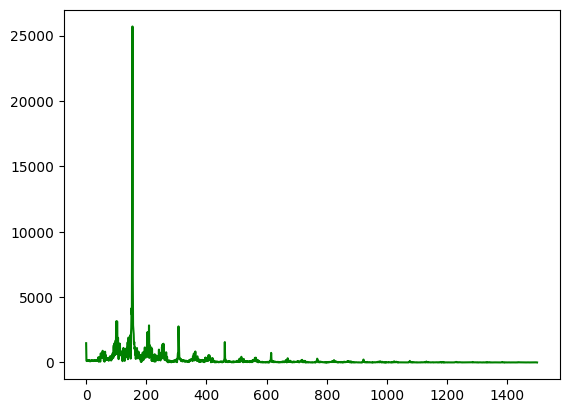

In [93]:
plt.plot(np.abs(np.fft.rfft(test_trajectory[0, 1001:]))[:k], label="True", color="Green")

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


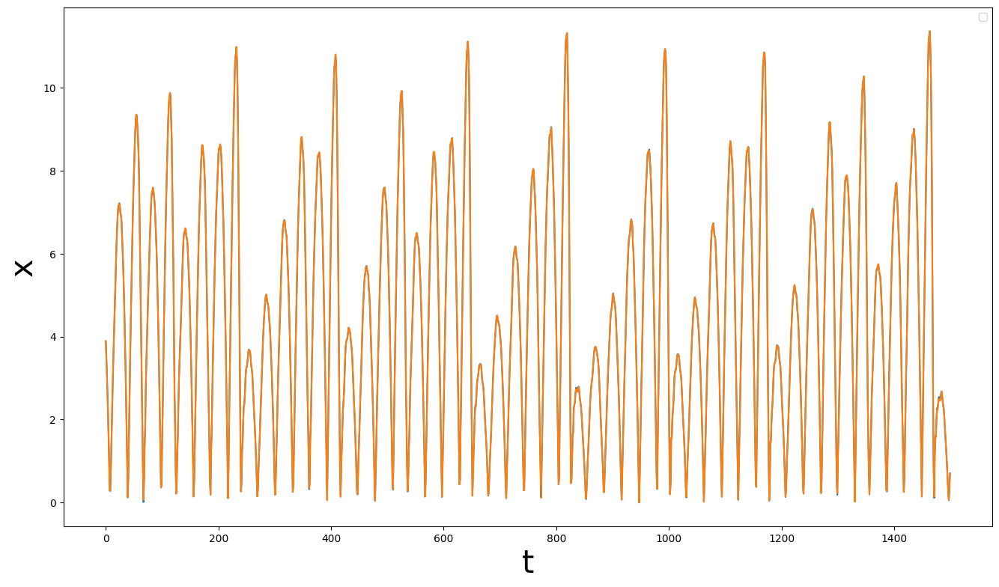

In [164]:
fig = plt.figure(figsize=(16, 9))
k = 1500

plt.plot(np.abs(np.fft.rfft(predict1[:, :, 0]))[:k])
plt.plot(np.abs(np.fft.rfft(predict2[:, :, 0]))[:k])

#plt.plot(np.abs(np.fft.rfft(test_trajectory[0, 1001:]))[:k], label="True", color="Green")
    
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.legend()

## Далекие матрицы

In [159]:
matrix1, matrix2 = ClosestMatrices(all_matrices[1], mode="Max")
predict1 = ReservoirPredictRossler(test_trajectory, reservoir, matrix1)
predict2 = ReservoirPredictRossler(test_trajectory, reservoir, matrix2)


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


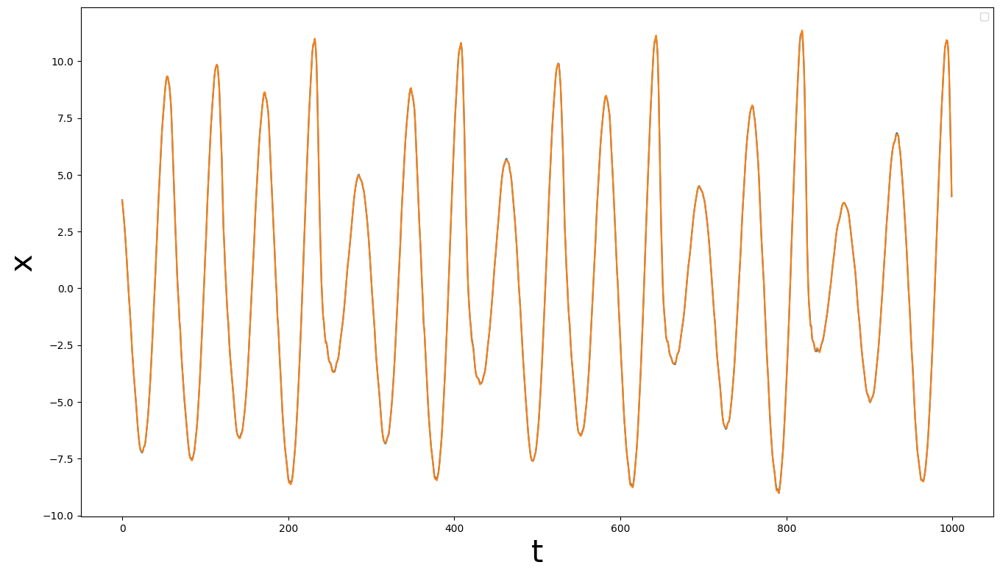

In [160]:
fig = plt.figure(figsize=(16, 9))

plt.plot(predict1[:, :, 0][:1000])
plt.plot(predict2[:, :, 0][:1000])

#plt.plot(test_trajectory[0, 1001:2101], label="True", color="Green")
    
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.legend()

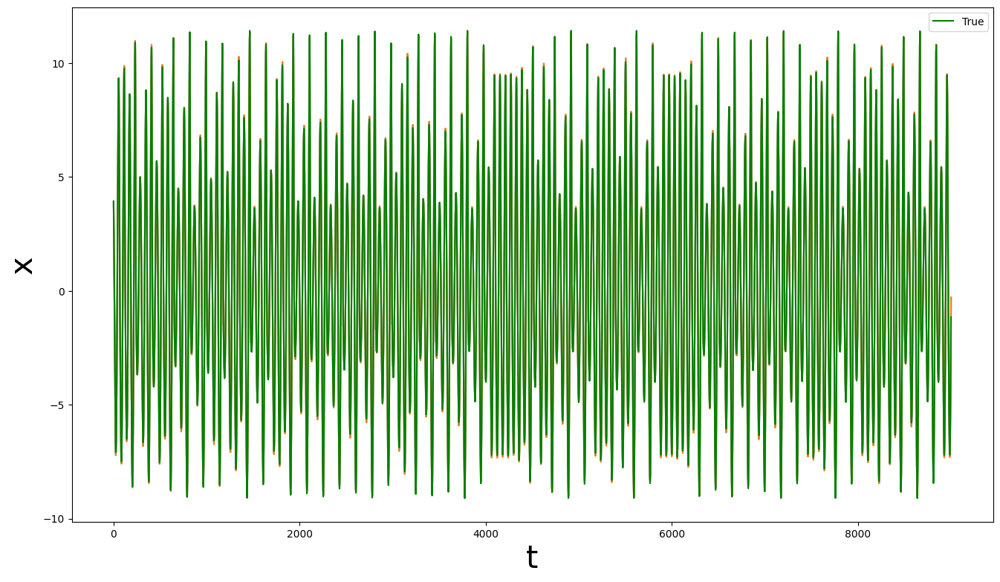

In [175]:
fig = plt.figure(figsize=(16, 9))

plt.plot(predict1[:, :, 0])
plt.plot(predict2[:, :, 0])

plt.plot(test_trajectory[0, 1001:], label="True", color="Green")
    
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.legend()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


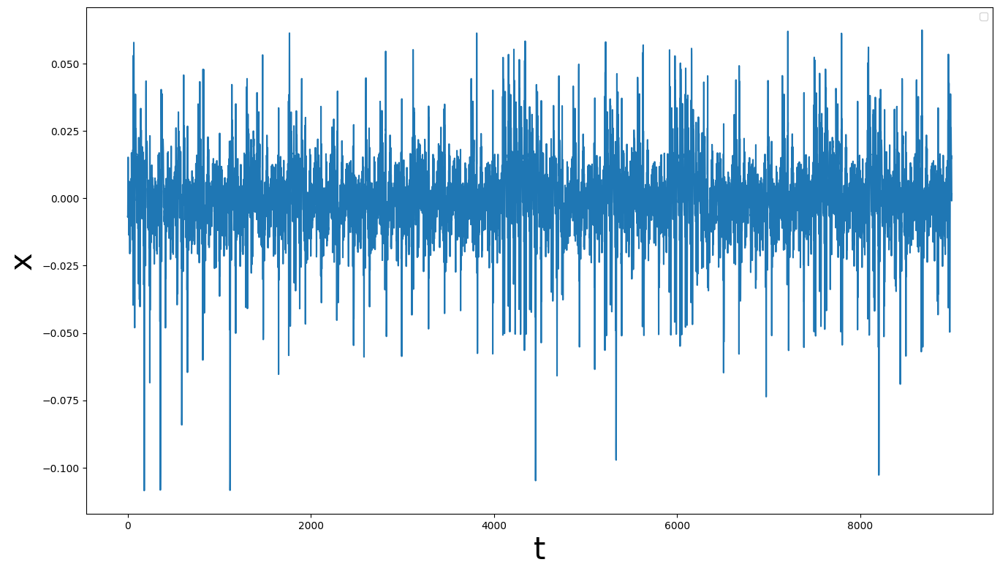

In [176]:
fig = plt.figure(figsize=(16, 9))

plt.plot(predict1[:, :, 0] - predict2[:, :, 0])
#plt.plot(predict2[:, :, 0])

#plt.plot(test_trajectory[0, 1001:], label="True", color="Green")
    
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.legend()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


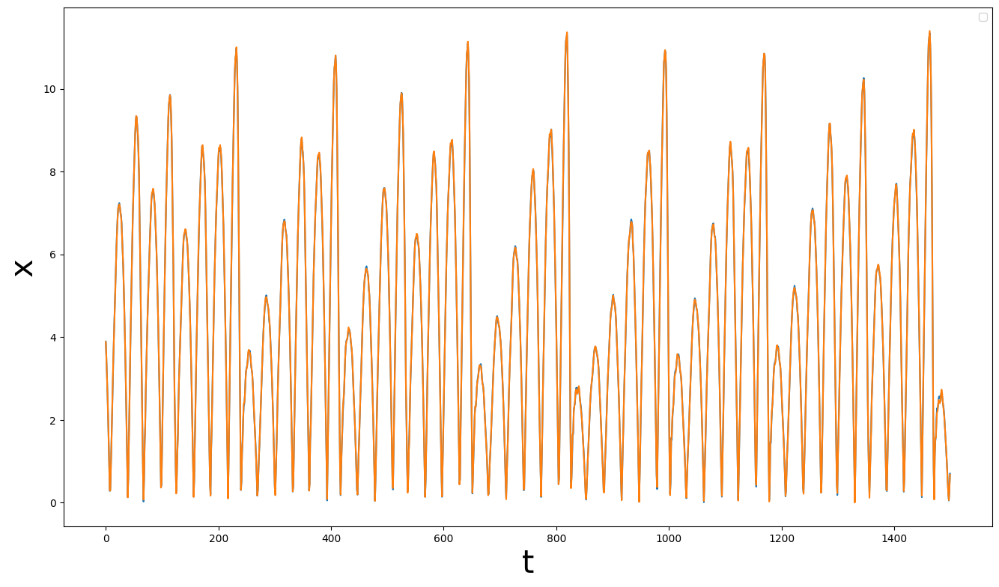

In [161]:
fig = plt.figure(figsize=(16, 9))
k = 1500

plt.plot(np.abs(np.fft.rfft(predict1[:, :, 0]))[:k])
plt.plot(np.abs(np.fft.rfft(predict2[:, :, 0]))[:k])

#plt.plot(np.abs(np.fft.fft(test_trajectory[0, 1001:]))[:k], label="True", color="Green")
    
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.legend()

In [132]:
means, stds = CalculateMeanStd(all_matrices)

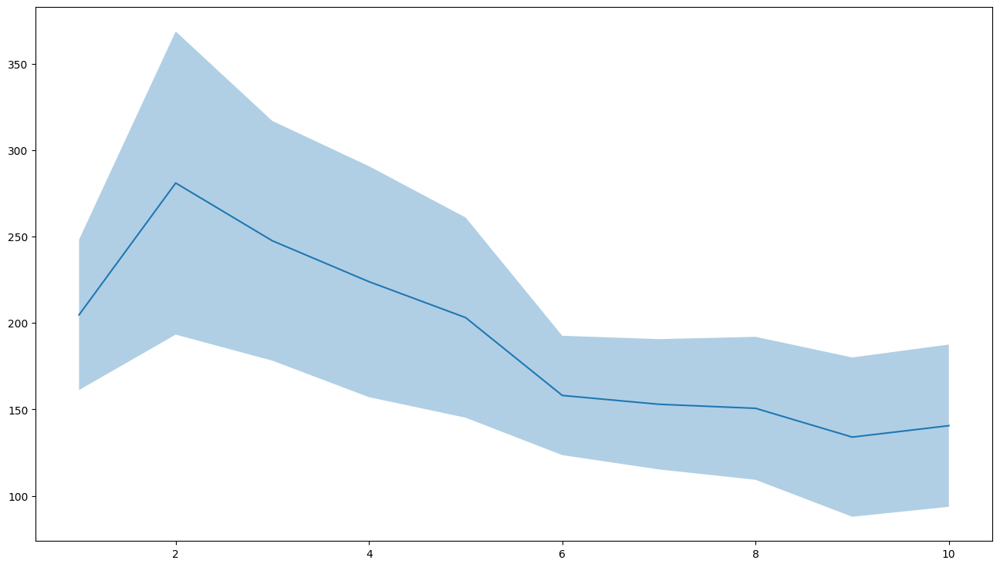

In [133]:
plt.figure(figsize=(16, 9))
plt.plot(np.arange(1, 11), means)
plt.fill_between(np.arange(1, 11), means - stds, means + stds, alpha=0.35)

## Mse

In [171]:
means, stds = CalculateMSE(all_matrices_predicts, test_trajectory.T[1001:])

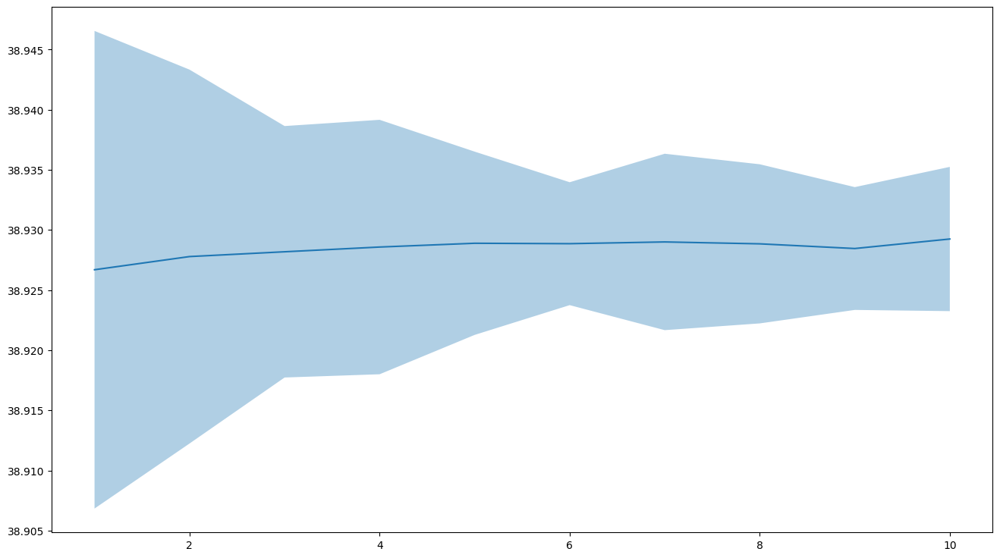

In [172]:
plt.figure(figsize=(16, 9))
plt.plot(np.arange(1, 11), means)
plt.fill_between(np.arange(1, 11), means - stds, means + stds, alpha=0.35)

In [173]:
means, stds = CalculateMSE(all_matrices_predicts, test_trajectory.T[1001:], mode="freq")


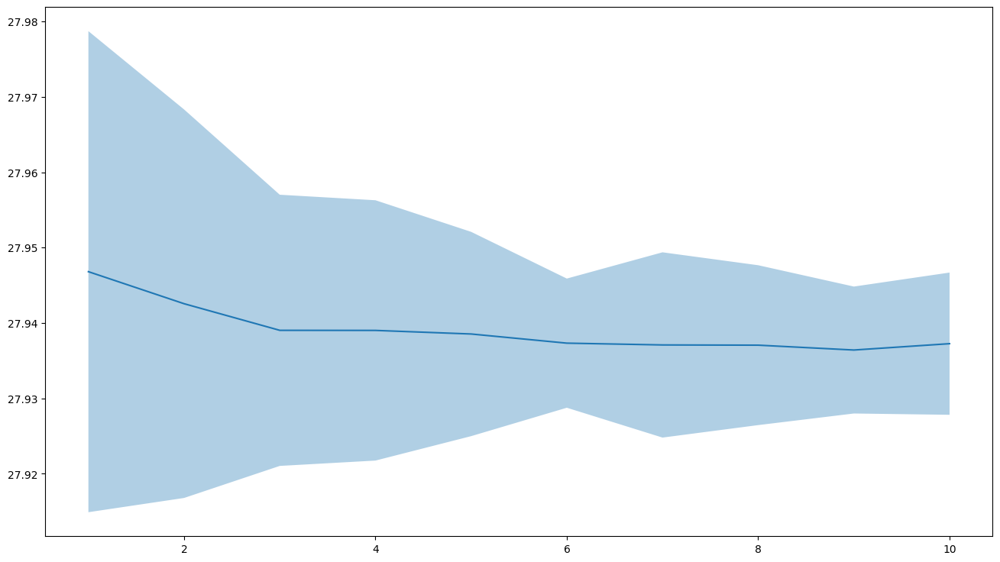

In [174]:
plt.figure(figsize=(16, 9))
plt.plot(np.arange(1, 11), means)
plt.fill_between(np.arange(1, 11), means - stds, means + stds, alpha=0.35)

# Rossler Autoregressive

In [5]:
a = b = 0.2
c = 5.7
def Rossler(t, X):
    x, y, z = X
    return [- y - z,
            x + a * y,
            b + z * (x - c)]

In [7]:
for i in tqdm(range(10)):
    start_point = np.array([np.random.uniform(-0.1, 0.1), np.random.uniform(-0.1, 0.1), np.random.uniform(-0.1, 0.1)])
    sol = solve_ivp(Rossler, [0, 1000], 
                    start_point, t_eval=np.arange(0, 1000, 0.01), rtol = 1e-11, atol = 1e-11, dense_output=True)
    np.save("data/Rossler0_01StepTest"+str(i), sol.y)

  0%|          | 0/10 [00:00<?, ?it/s]

In [ ]:
# np.random.seed(42)
# for i in tqdm(range(200)):
#     start_point = np.array([np.random.uniform(-0.1, 0.1), np.random.uniform(-0.1, 0.1), np.random.uniform(-0.1, 0.1)])
#     sol = solve_ivp(Rossler, [0, 1000], 
#                     start_point, t_eval=np.arange(0, 1000, 0.01), rtol = 1e-11, atol = 1e-11, dense_output=True)
#     np.save("data/Rossler0_01Step"+str(i), sol.y)

  0%|          | 0/1 [00:00<?, ?it/s]

In [19]:
trajectorys = []
for i in range(201):
    trajectorys.append(np.load("data/Rossler0_01Step"+str(i) + ".npy"))

In [40]:
test_trajectorys = []
for i in range(10):
    test_trajectorys.append(np.load("data/Rossler0_01StepTest"+str(i) + ".npy"))

In [20]:
trajectorys_resample = [trajectory.T[10000:][::10] for trajectory in trajectorys]

In [ ]:
trajectorys_resample = [trajectory.T[10000:][::10] for trajectory in trajectorys]
all_matrices = CalculateMatrices(trajectorys_resample, dim=3)
np.savez("predicts/all201_matricesRossler2.npz", *all_matrices)

Шаг:  1


  0%|          | 0/200 [00:00<?, ?it/s]

Шаг:  2


  0%|          | 0/100 [00:00<?, ?it/s]

Шаг:  3


  0%|          | 0/66 [00:00<?, ?it/s]

Шаг:  4


  0%|          | 0/50 [00:00<?, ?it/s]

Шаг:  5


  0%|          | 0/40 [00:00<?, ?it/s]

Шаг:  6


  0%|          | 0/33 [00:00<?, ?it/s]

In [ ]:
#np.savez("predicts/all201_matricesRossler.npz", *all_matrices)

In [23]:
loaded_data = np.load("predicts/all201_matricesRossler2.npz")
loaded_matrices = [loaded_data[f'arr_{i}'] for i in range(len(loaded_data.files))]

## Расстояние матриц

In [24]:
means, stds, distances = CalculateMeanStd(loaded_matrices)


In [25]:
perc10 = [np.percentile(distances[i], 10) for i in range(len(distances))]
perc90 = [np.percentile(distances[i], 90) for i in range(len(distances))]


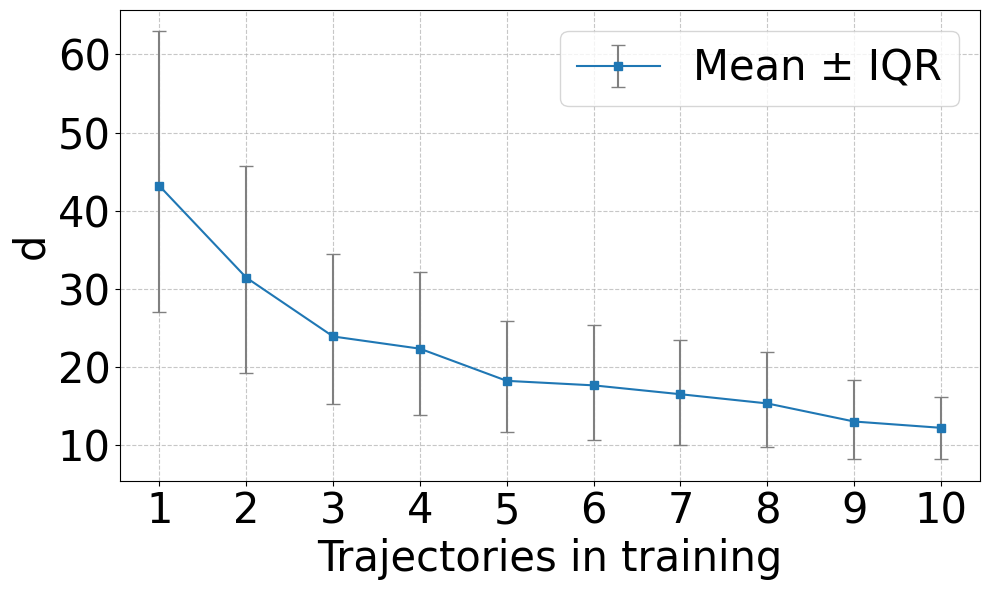

In [27]:
plt.figure(figsize=(10, 6))
plt.errorbar(
    x=range(1, 11),
    y=means,
    yerr=[means - perc10, perc90 - means],
    fmt='-s',
    ecolor='gray',
    capsize=5,
    label='Mean ± IQR'
)

#plt.title('Trend of Values Across Time Steps (Median with IQR)')
plt.xlabel('Trajectories in training', fontsize=30)
plt.ylabel('d', fontsize=30)
plt.grid(True, linestyle='--', alpha=0.7)
plt.xticks(range(1, 11), fontsize=30)
plt.yticks(fontsize=30)

plt.legend(fontsize=30)
plt.tight_layout()
plt.show()

In [41]:
test_trajectorys_resampled = [test_trajectory.T[10000:][::10] for test_trajectory in test_trajectorys]

In [ ]:
test_trajectorys_predicts = []
for traj_number, test_trajectory_resampled in enumerate(test_trajectorys_resampled):
    print("Траектория ", traj_number)
    all_matrices_predicts = []
    for i in tqdm(range(len(loaded_matrices)), leave=False):
        current_matrices_predicts = []
        for j in tqdm(range(20), leave=False):#len(loaded_matrices[i])):
            predicts = ReservoirPredict(test_trajectory_resampled, reservoir, loaded_matrices[i][j], dim=3)
            current_matrices_predicts.append(predicts)
        all_matrices_predicts.append(np.array(current_matrices_predicts))
    test_trajectorys_predicts.append(np.array(all_matrices_predicts))

Траектория  0


  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

Траектория  1


  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

Траектория  2


  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

Траектория  3


  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

Траектория  4


  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

Траектория  5


  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

Траектория  6


  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

In [29]:
len(test_trajectorys_predicts[0][0])

20

In [30]:
np.save("predicts/10Trajectorys_predictsRossler", test_trajectorys_predicts)


In [ ]:
# all_matrices_predicts = []

# for i in range(len(loaded_matrices)):
#     current_matrices_predicts = []
#     print(i+1)
#     for j in tqdm(range(20)):#len(loaded_matrices[i])):
#         predicts = ReservoirPredict(trajectorys_resample[-1], reservoir, loaded_matrices[i][j], dim=3)
#         current_matrices_predicts.append(predicts)
#     all_matrices_predicts.append(current_matrices_predicts)
# np.savez("predicts/all201_matrices_predictsRosslerLong.npz", *all_matrices_predicts) #Rossler2 for test_trajectory prediction


1


  0%|          | 0/20 [00:00<?, ?it/s]

In [21]:
loaded_data = np.load("predicts/all201_matrices_predictsRosslerLong.npz")
all_matrices_predicts = [loaded_data[f'arr_{i}'] for i in range(len(loaded_data.files))]

## Отрисовка

In [22]:
test_trajectory_resampled = trajectorys_resample[-1]
test_trajectory_resampled.shape

(9000, 3)

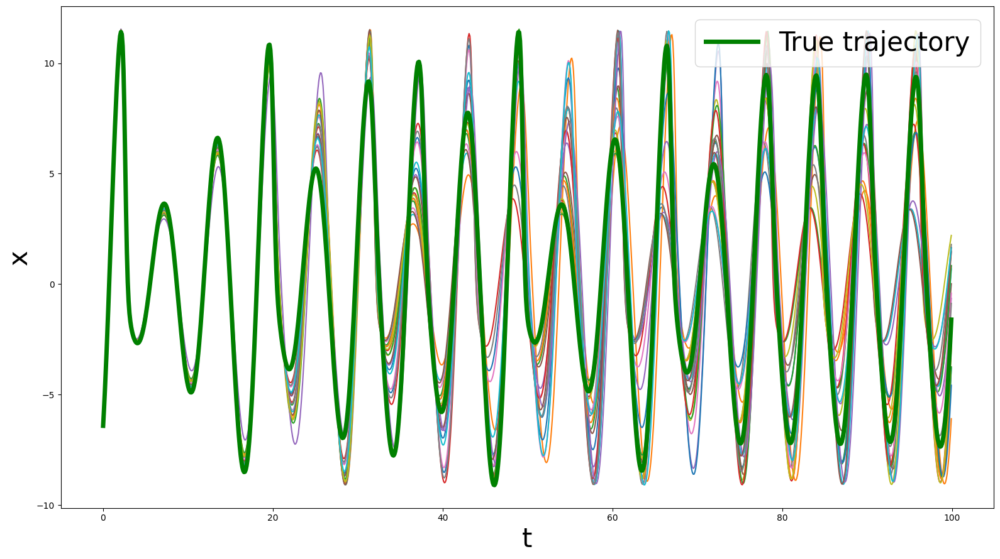

In [40]:
plt.figure(figsize=(16, 9))

# Рисуем графики
#for row, i in enumerate([0, 5, 9]):
for j in range(20):
    plt.plot(np.arange(0, 100, 0.1), all_matrices_predicts[0][j][:, 0][:1000])
plt.plot(np.arange(0, 100, 0.1), test_trajectory_resampled[2501:3501, 0], label="True trajectory", color="Green", linewidth = 5)

#plt.title(str(1) + ' trajectory in training')
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.legend(fontsize=30)
plt.tight_layout()

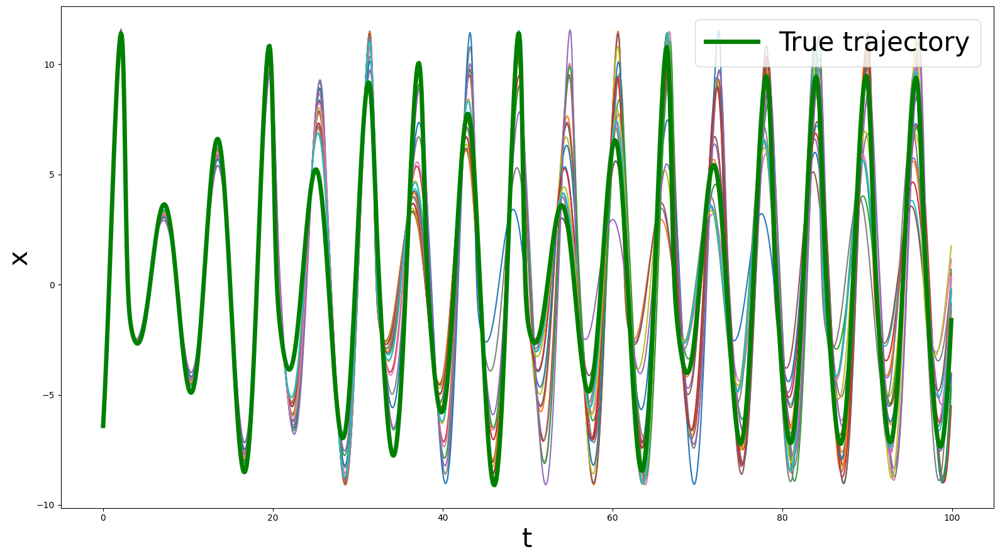

In [39]:
plt.figure(figsize=(16, 9))

# Рисуем графики
#for row, i in enumerate([0, 5, 9]):
for j in range(20):
    plt.plot(np.arange(0, 100, 0.1), all_matrices_predicts[5][j][:, 0][:1000])
plt.plot(np.arange(0, 100, 0.1), test_trajectory_resampled[2501:3501, 0], label="True trajectory", color="Green", linewidth = 5)

#plt.title(str(1) + ' trajectory in training')
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.legend(fontsize=30)
plt.tight_layout()

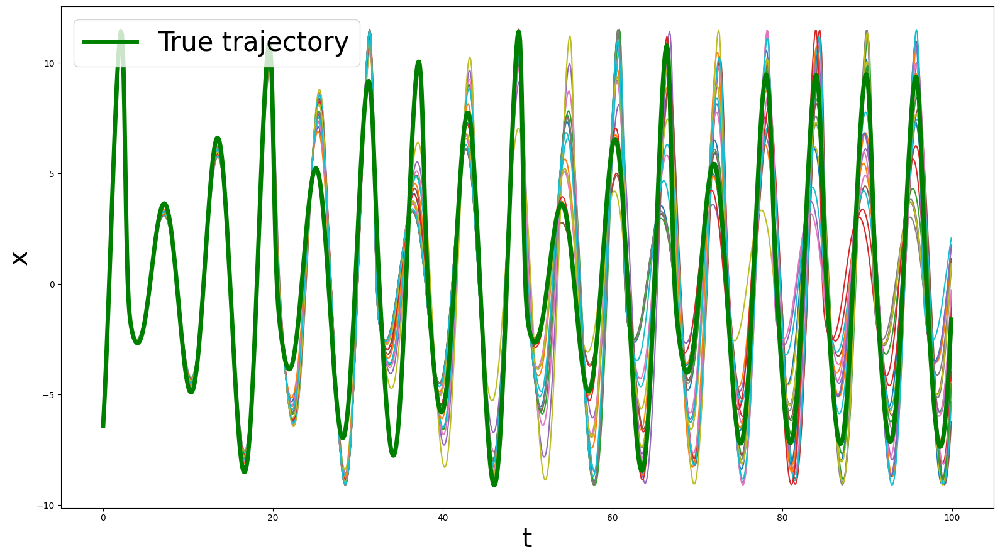

In [38]:
plt.figure(figsize=(16, 9))

# Рисуем графики
#for row, i in enumerate([0, 5, 9]):
for j in range(20):
    plt.plot(np.arange(0, 100, 0.1), all_matrices_predicts[9][j][:, 0][:1000])
plt.plot(np.arange(0, 100, 0.1), test_trajectory_resampled[2501:3501, 0], label="True trajectory", color="Green", linewidth = 5)

#plt.title(str(1) + ' trajectory in training')
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.legend(fontsize=30)
plt.tight_layout()

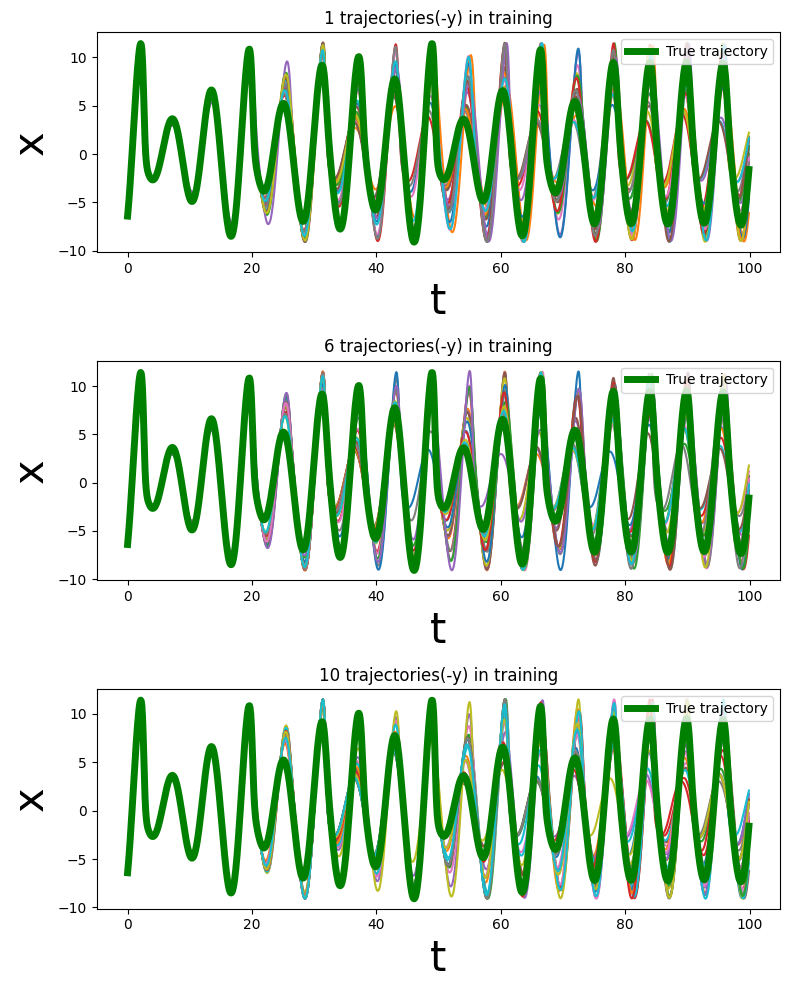

In [37]:
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(8, 10))

# Рисуем графики
for row, i in enumerate([0, 5, 9]):
    for j in range(20):
        axes[row].plot(np.arange(0, 100, 0.1), all_matrices_predicts[i][j][:, 0][:1000])
    axes[row].plot(np.arange(0, 100, 0.1), test_trajectory_resampled[2501:3501, 0], label="True trajectory", color="Green", linewidth = 5)
    
    axes[row].set_title(str(i+1) + ' trajectories(-y) in training')
    axes[row].set_xlabel("t", fontsize=30)
    axes[row].set_ylabel("x", fontsize=30)
    axes[row].legend()
plt.tight_layout()

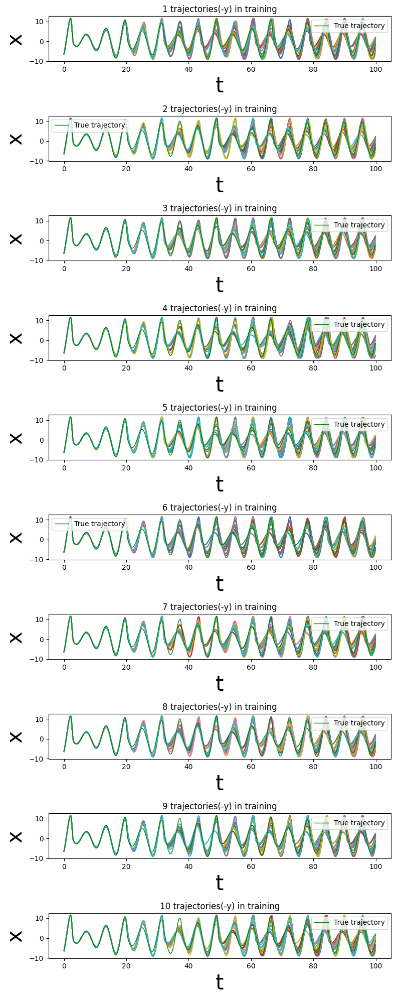

In [35]:
fig, axes = plt.subplots(nrows=10, ncols=1, figsize=(8, 20))

# Рисуем графики
for i in range(10):
    for j in range(20):
        axes[i].plot(np.arange(0, 100, 0.1), all_matrices_predicts[i][j][:, 0][:1000])
    axes[i].plot(np.arange(0, 100, 0.1), test_trajectory_resampled[2501:3501, 0], label="True trajectory", color="Green", linewidth = 1)
    axes[i].set_title(str(i+1) + ' trajectories(-y) in training')
    axes[i].set_xlabel("t", fontsize=30)
    axes[i].set_ylabel("x", fontsize=30)
    axes[i].legend()
plt.tight_layout()

## Близкие матрицы

In [43]:
matrix1, matrix2 = ClosestMatrices(loaded_matrices[0])
predict1 = ReservoirPredict(test_trajectory_resampled, reservoir, matrix1, dim=3)
predict2 = ReservoirPredict(test_trajectory_resampled, reservoir, matrix2, dim=3)


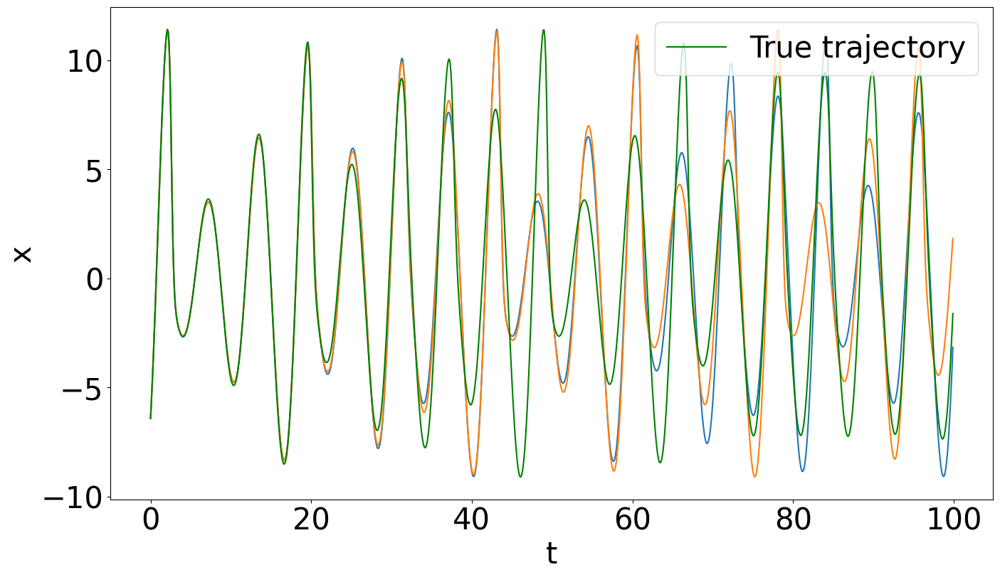

In [44]:
fig = plt.figure(figsize=(16, 9))

plt.plot(np.arange(0, 100, 0.1), predict1[:, 0][:1000])
plt.plot(np.arange(0, 100, 0.1), predict2[:, 0][:1000])

plt.plot(np.arange(0, 100, 0.1), test_trajectory_resampled[2501:3501, 0], label="True trajectory", color="Green")
    
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)

plt.legend(fontsize=30)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


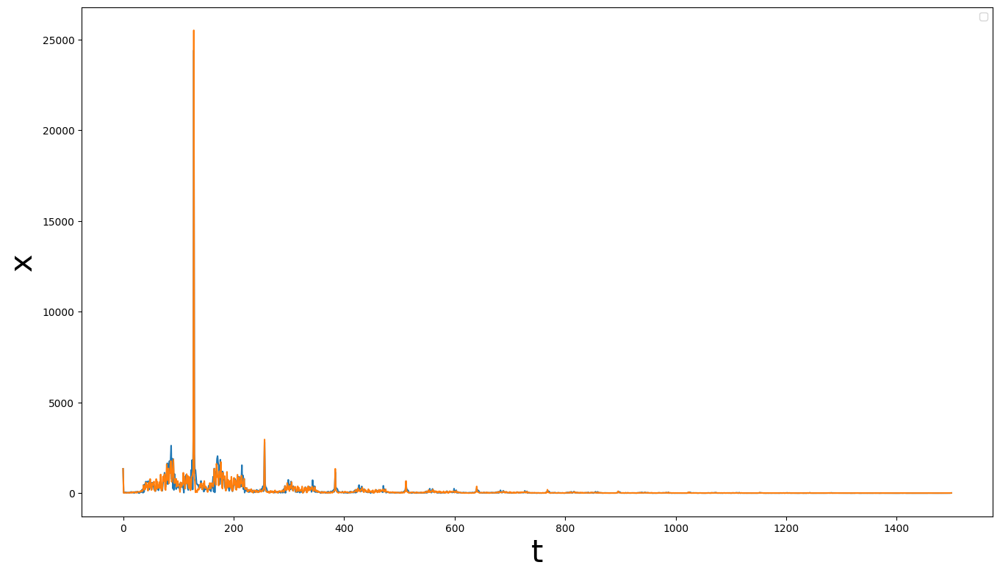

In [19]:
fig = plt.figure(figsize=(16, 9))
k = 1500

plt.plot(np.abs(np.fft.fft(predict1[:, 0]))[:k])
plt.plot(np.abs(np.fft.fft(predict2[:, 0]))[:k])

#plt.plot(np.abs(np.fft.fft(test_trajectory_resampled[2501:, 0]))[:k], label="True", color="Green")
    
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.legend()

## Далекие матрицы

In [45]:
matrix1, matrix2 = ClosestMatrices(loaded_matrices[0], mode="Max")
predict1 = ReservoirPredict(test_trajectory_resampled, reservoir, matrix1, dim=3)
predict2 = ReservoirPredict(test_trajectory_resampled, reservoir, matrix2, dim=3)


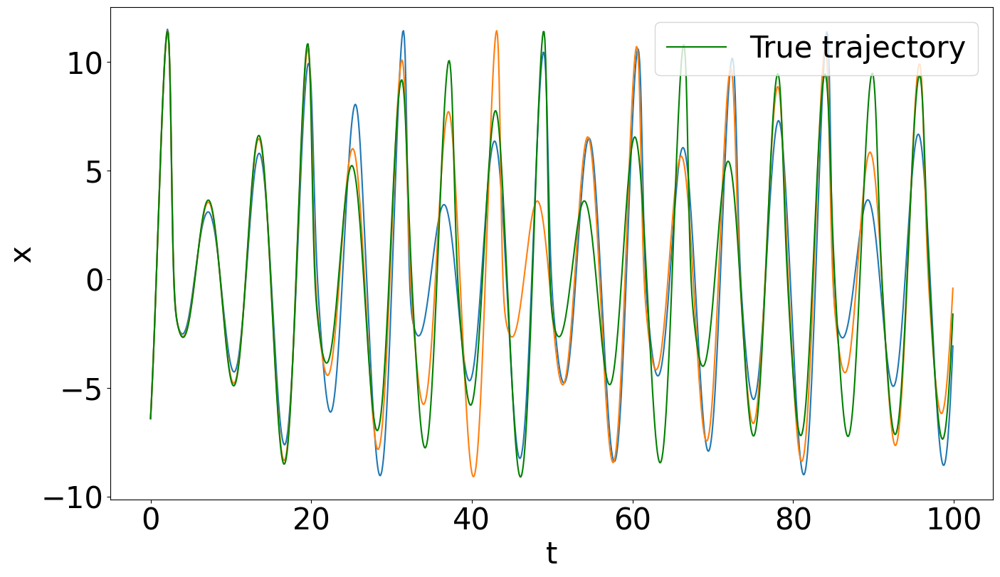

In [46]:
fig = plt.figure(figsize=(16, 9))

plt.plot(np.arange(0, 100, 0.1), predict1[:, 0][:1000])
plt.plot(np.arange(0, 100, 0.1), predict2[:, 0][:1000])

plt.plot(np.arange(0, 100, 0.1), test_trajectory_resampled[2501:3501, 0], label="True trajectory", color="Green")
    
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)

plt.legend(fontsize=30)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


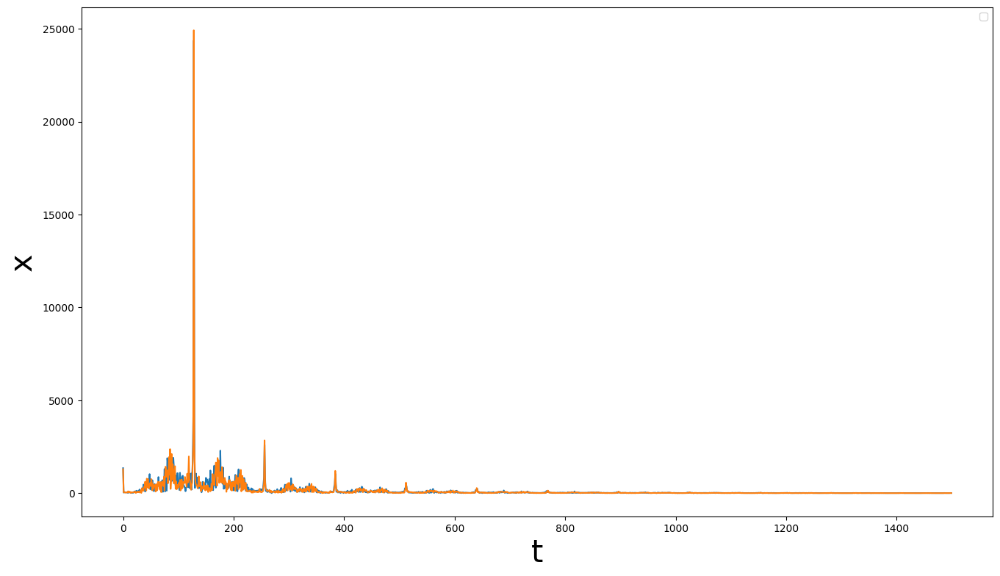

In [37]:
fig = plt.figure(figsize=(16, 9))
k = 1500

plt.plot(np.abs(np.fft.fft(predict1[:, 0]))[:k])
plt.plot(np.abs(np.fft.fft(predict2[:, 0]))[:k])

#plt.plot(np.abs(np.fft.fft(test_trajectory_resampled[2501:, 0]))[:k], label="True", color="Green")
    
plt.xlabel("t", fontsize=30)
plt.ylabel("x", fontsize=30)
plt.legend()

## Смена режима

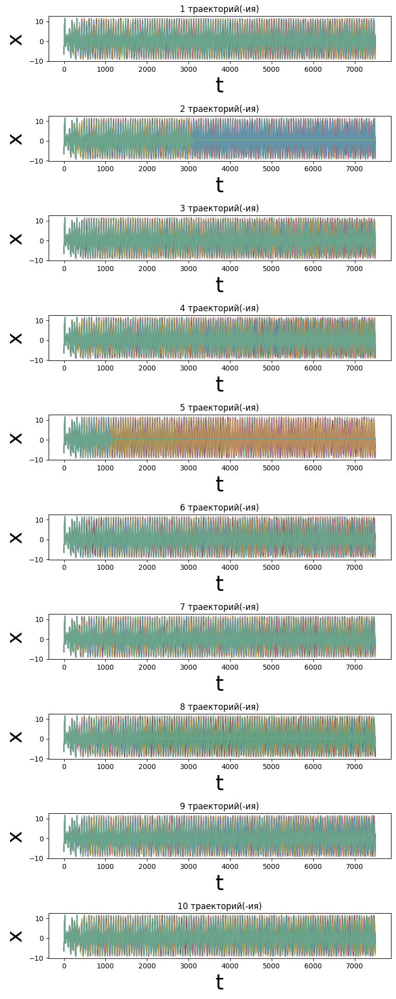

In [33]:
fig, axes = plt.subplots(nrows=10, ncols=1, figsize=(8, 20))

# Рисуем графики
for i in range(10):
    for j in range(20):#range(len(all_matrices_predicts[i])):
        axes[i].plot(all_matrices_predicts[i][j][:, 0], alpha=0.5)
    #axes[i].plot(test_trajectory_resampled[2501:, 0], label="True", color="Green", linewidth = 5)
    
    axes[i].set_title(str(i+1) + ' траекторий(-ия)')
    axes[i].set_xlabel("t", fontsize=30)
    axes[i].set_ylabel("x", fontsize=30)
    #axes[i].legend()
plt.tight_layout()

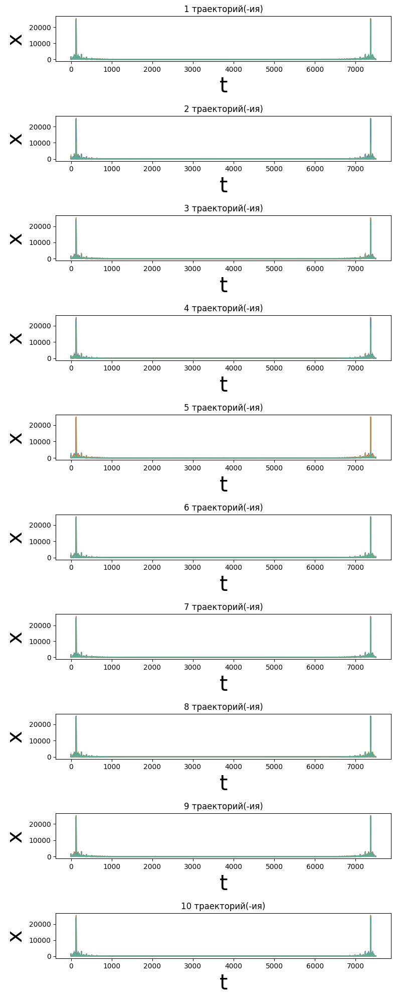

In [34]:
fig, axes = plt.subplots(nrows=10, ncols=1, figsize=(8, 20))

# Рисуем графики
for i in range(10):
    for j in range(20):#range(len(all_matrices_predicts[i])):
        axes[i].plot(np.abs(np.fft.fft(all_matrices_predicts[i][j][:, 0])), alpha=0.5)
    #axes[i].plot(test_trajectory_resampled[2501:, 0], label="True", color="Green", linewidth = 5)
    
    axes[i].set_title(str(i+1) + ' траекторий(-ия)')
    axes[i].set_xlabel("t", fontsize=30)
    axes[i].set_ylabel("x", fontsize=30)
    #axes[i].legend()
plt.tight_layout()

## Количество затухающих траекторий

In [103]:
np.argmax(np.array(mses[0]) > 1000)


40

In [116]:
all_matrices_predicts[0][0][7000:, 0].std()


5.116083167804835

In [108]:
len(all_matrices_predicts[0])

200

In [130]:
all_silence = []
for i in range(10):
    c = 0
    for j in range(len(all_matrices_predicts[i])):
        if (all_matrices_predicts[i][j][7000:, 0].std() < 5) or (all_matrices_predicts[i][j][7000:, 1].std() < 4.5) or (all_matrices_predicts[i][j][7000:, 2].std() < 2.5):
            print(i, j)
            c += 1
    all_silence.append(c)

0 14
1 15
1 18
2 7
3 11
3 18
4 12
4 17
4 19
5 12
5 14
6 12
6 13
7 16


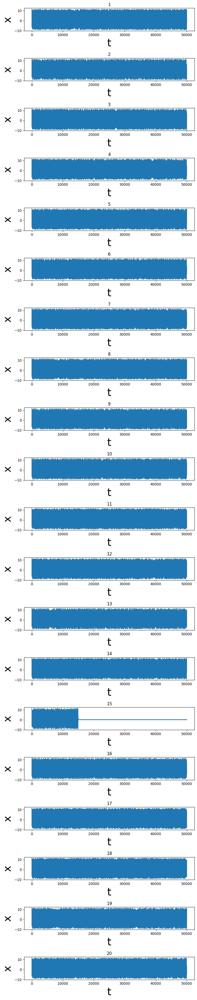

In [126]:
fig, axes = plt.subplots(nrows=20, ncols=1, figsize=(8, 40))

j = 0
# Рисуем графики
for i in range(20):
   
    axes[i].plot(all_matrices_predicts[j][i][:, 0])
    #axes[i].plot(test_trajectory_resampled[2501:, 0], label="True", color="Green", linewidth = 5)

    axes[i].set_title(str(i+1))
    axes[i].set_xlabel("t", fontsize=30)
    axes[i].set_ylabel("x", fontsize=30)
    #axes[i].legend()
plt.tight_layout()

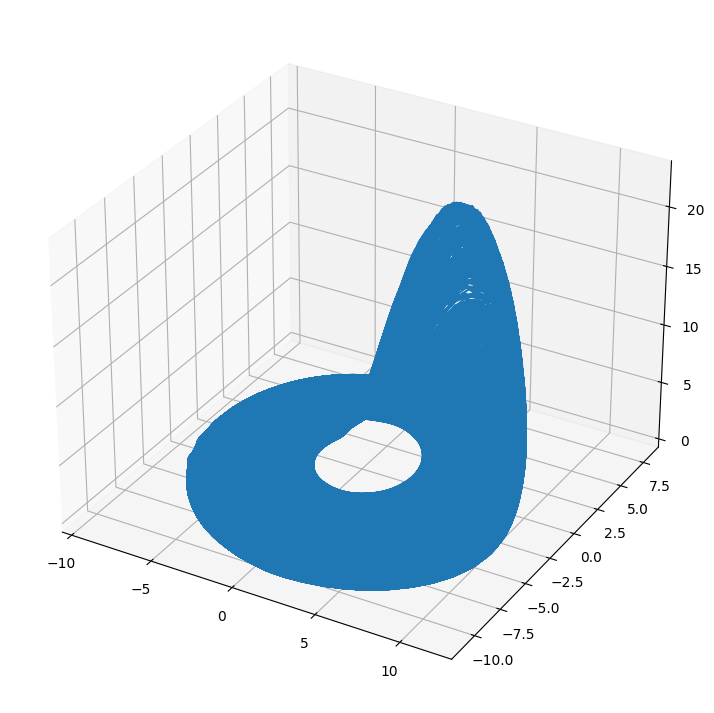

In [127]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot(projection='3d')
i = 6
ax.plot(all_matrices_predicts[j][7][:, 0], all_matrices_predicts[j][7][:, 1], all_matrices_predicts[j][7][:, 2])


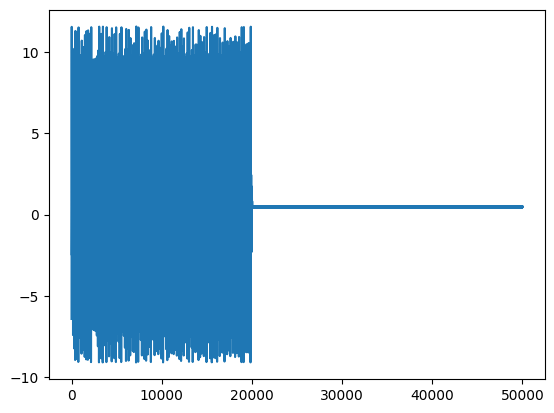

In [13]:
plt.plot(all_matrices_predicts[6][12][:, 0])

Text(0.5, 0, 'Number of trajectories in training')

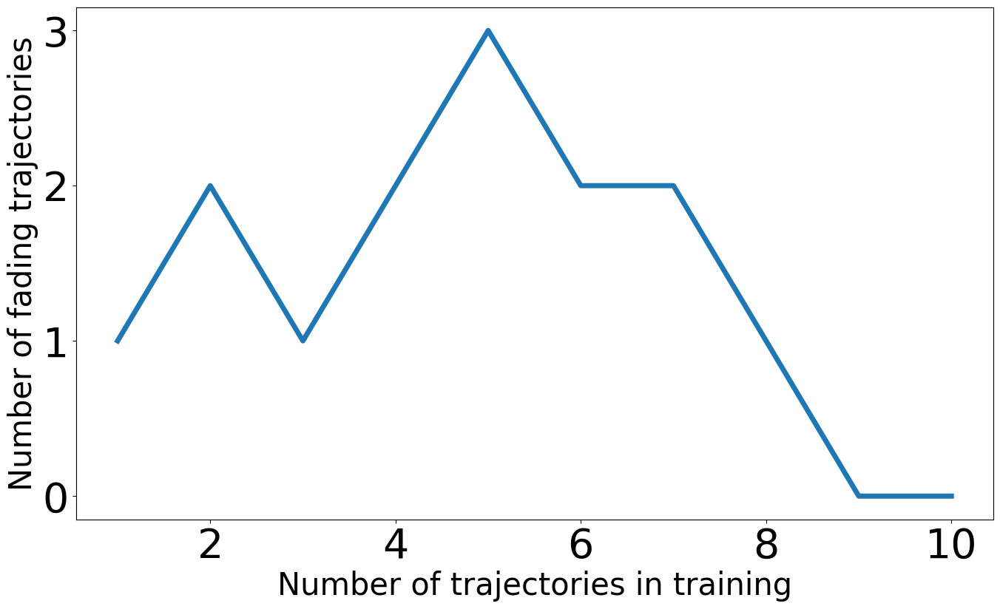

In [131]:
plt.figure(figsize=(16, 9))
plt.plot(np.arange(1, 11), all_silence, linewidth=5)
plt.tick_params(axis='both', which='major', labelsize=40)

plt.ylabel("Number of fading trajectories", fontsize=30)
plt.xlabel("Number of trajectories in training", fontsize=30)


## MSE

In [ ]:
all_matrices_predicts_short = [[all_matrices_predicts[i][j][:-1000] 
                                for j in range(len(all_matrices_predicts[i]))] 
                               for i in range(len(all_matrices_predicts))]

In [39]:
ross_trajs = np.load("predicts/10Trajectorys_predictsRossler.npy")

In [45]:
ross_trajs[0].shape

(10, 20, 7499, 3)

In [42]:
test_traj = test_trajectorys_resampled[0]

In [46]:
test_traj.shape

(9000, 3)

In [48]:
means, stds, mses = CalculateMSE(ross_trajs[0][:, :, :-1000], test_traj[2501:])

In [53]:
test_traj.shape

(9000, 3)

In [52]:
test_traj[:, 0].std()

5.163462638345846

In [49]:
print("min mse 1:", np.min(mses[0]), "max mse 1:", np.max(mses[0]))


min mse 1: 6.957020154551879 max mse 1: 20.641965606229338


In [50]:
print("min mse 10:", np.min(mses[9]), "max mse 10:", np.max(mses[9]))


min mse 10: 6.572562451600762 max mse 10: 17.051262738320375


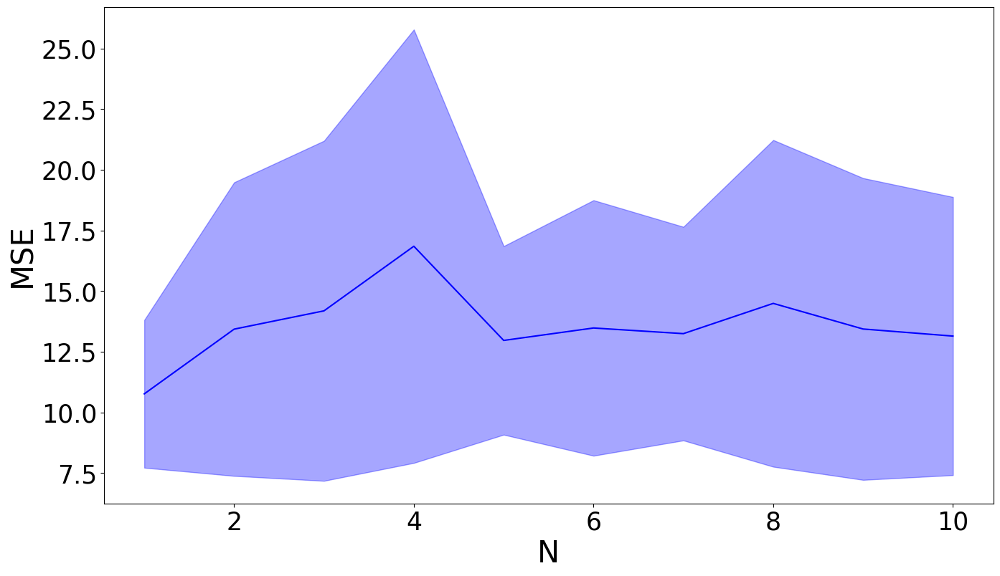

In [38]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot()
ax.plot(np.arange(1, 11), means, color="blue")
ax.fill_between(np.arange(1, 11), means-stds, means + stds, alpha=0.35, color="blue")

ax.set_xlabel("N", size=30)
ax.set_ylabel("MSE", size=30)
ax.tick_params(axis='both', which='major', labelsize=25)

In [41]:
mses_without_outliers = []
for i in range(len(mses)):
    current_mses = []
    for j in range(len(mses[i])):
        if mses[i][j] < 1000:
            current_mses.append(mses[i][j])
    mses_without_outliers.append(current_mses)

In [42]:
means = [np.mean(mse) for mse in mses_without_outliers]

In [48]:
perc10 = [np.percentile(mses[i], 10) for i in range(len(mses))]
perc90 = [np.percentile(mses[i], 98) for i in range(len(mses))]


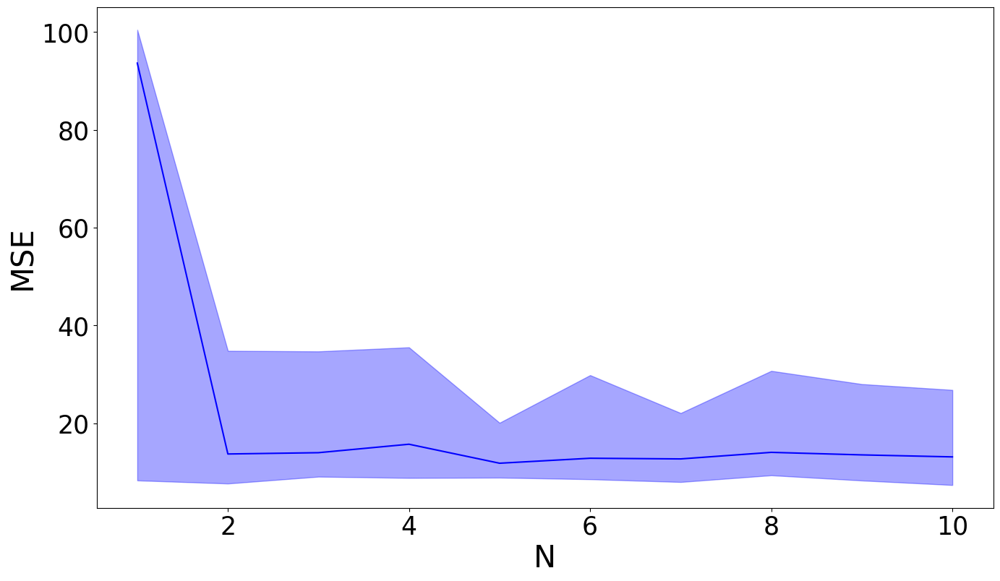

In [49]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot()
ax.plot(np.arange(1, 11), means, color="blue")
ax.fill_between(np.arange(1, 11), perc10, perc90, alpha=0.35, color="blue")

ax.set_xlabel("N", size=30)
ax.set_ylabel("MSE", size=30)
ax.tick_params(axis='both', which='major', labelsize=25)

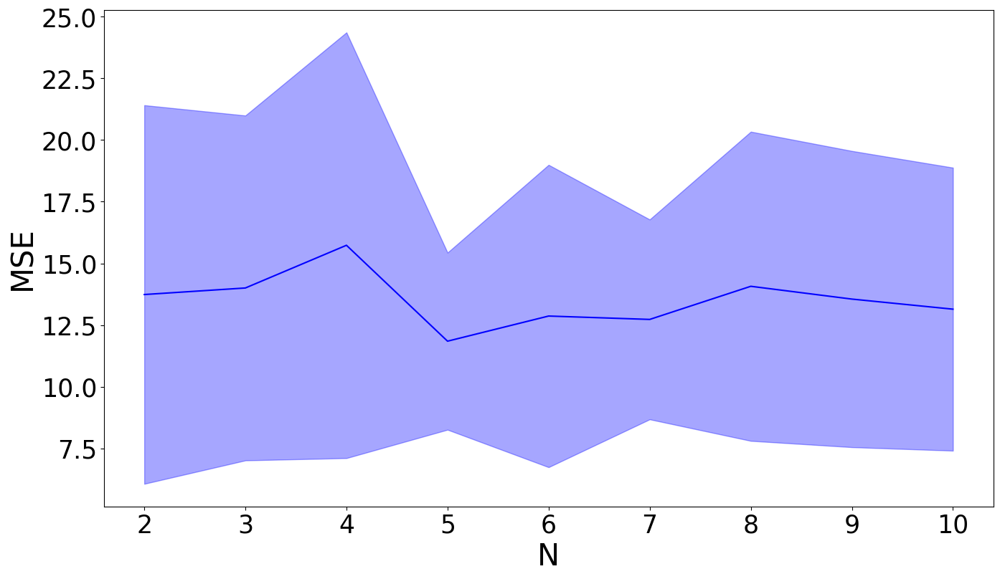

In [68]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot()
ax.plot(np.arange(2, 11), means[1:], color="blue")
ax.fill_between(np.arange(2, 11), (means - stds)[1:], (means + stds)[1:], alpha=0.35, color="blue")

ax.set_xlabel("N", size=30)
ax.set_ylabel("MSE", size=30)
ax.tick_params(axis='both', which='major', labelsize=25)

In [50]:
means, stds, mses = CalculateMSE(all_matrices_predicts_short, test_trajectory_resampled[2501:], mode="fft")


In [61]:
perc10 = [np.percentile(mses[i], 10) for i in range(len(mses))]
perc90 = [np.percentile(mses[i], 98.01) for i in range(len(mses))]


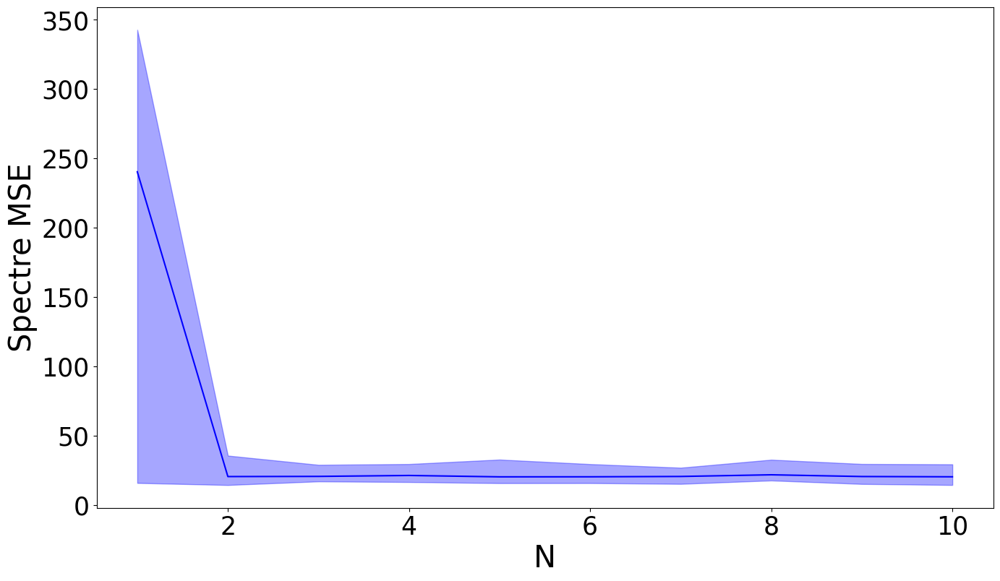

In [62]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot()
ax.plot(np.arange(1, 11), means, color="blue")
ax.fill_between(np.arange(1, 11), perc10, perc90, alpha=0.35, color="blue")

ax.set_xlabel("N", size=30)
ax.set_ylabel("Spectre MSE", size=30)
ax.tick_params(axis='both', which='major', labelsize=25)

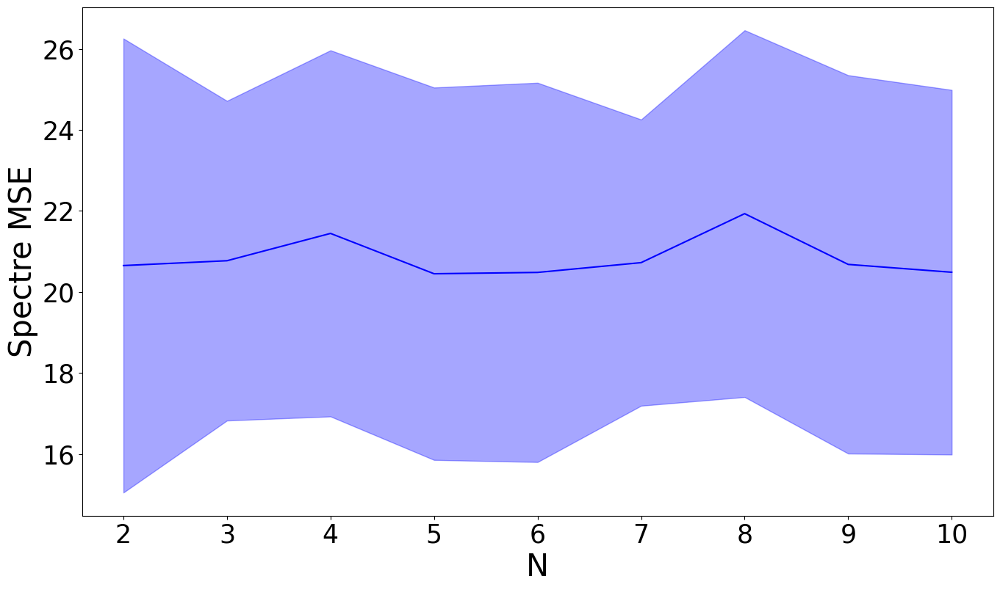

In [71]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot()
ax.plot(np.arange(2, 11), means[1:], color="blue")
ax.fill_between(np.arange(2, 11), (means - stds)[1:], (means + stds)[1:], alpha=0.35, color="blue")

ax.set_xlabel("N", size=30)
ax.set_ylabel("Spectre MSE", size=30)
ax.tick_params(axis='both', which='major', labelsize=25)

## Пример


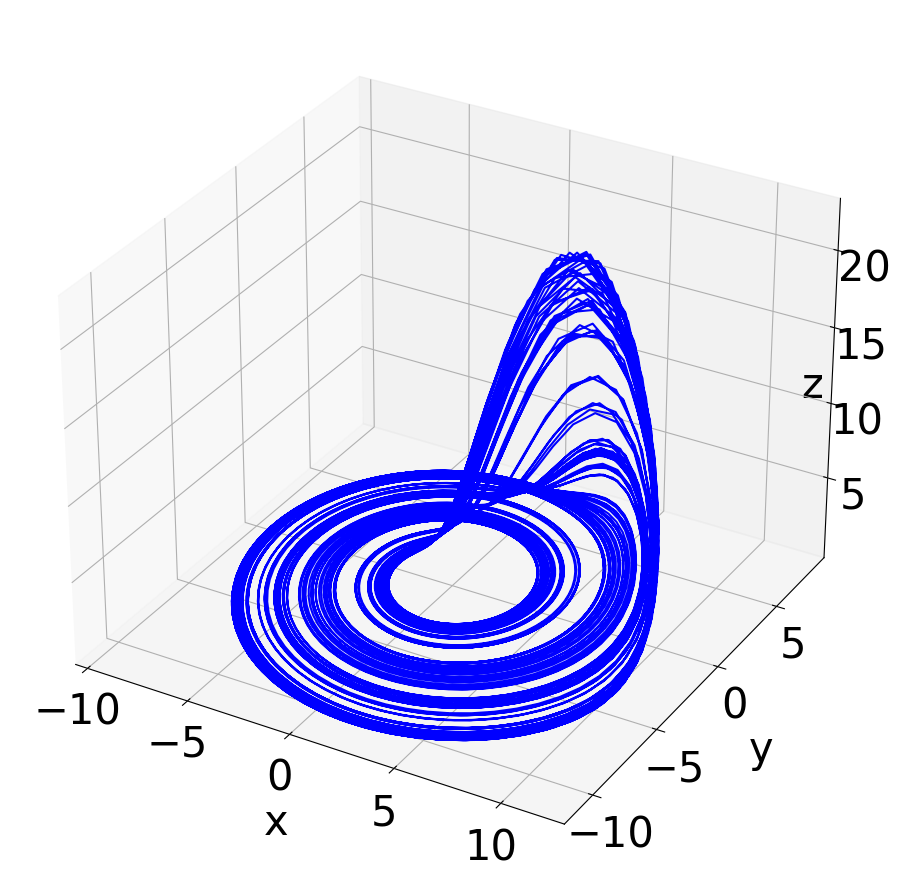

In [12]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot(projection='3d')
ax.plot(test_trajectory_resampled[1000:, 0], test_trajectory_resampled[1000:, 1], test_trajectory_resampled[1000:, 2], color="blue")

ax.set_xlabel("x", size=30, labelpad=20)
ax.set_ylabel("y", size=30, labelpad=20)
ax.set_zlabel("z", size=30, labelpad=-30)

ax.tick_params(axis='both', which='major', labelsize=30)

plt.tight_layout()

In [73]:
predicts = ReservoirPredict(trajectorys_resample[-1], reservoir, loaded_matrices[0][1], dim=3)

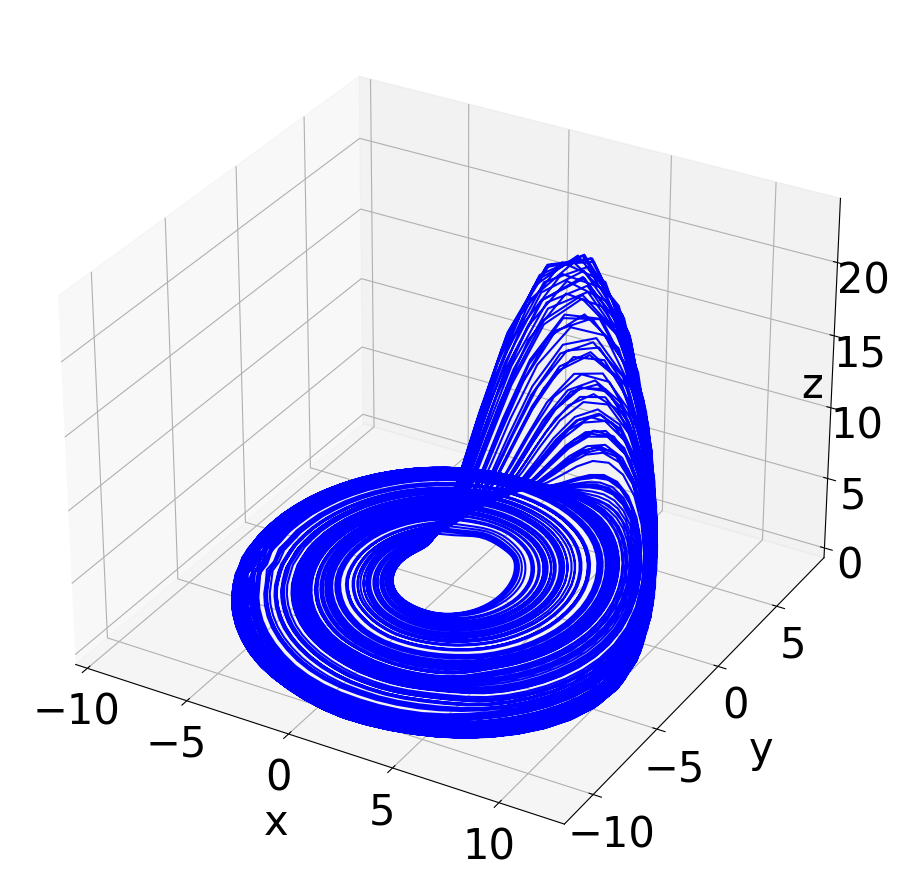

In [88]:
fig = plt.figure(figsize=(16, 9))
ax = fig.add_subplot(projection='3d')
ax.plot(predicts[:, 0], predicts[:, 1], predicts[:, 2], color="blue")

ax.set_xlabel("x", size=30, labelpad=20)
ax.set_ylabel("y", size=30, labelpad=20)
ax.set_zlabel("z", size=30, labelpad=-30)

ax.tick_params(axis='both', which='major', labelsize=30)

plt.tight_layout()